<a href="https://colab.research.google.com/github/KeeJin/Pest_Object_Detection_System/blob/master/Pest_ODS_RetinaNet_TF2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Pest Detector for food establishments
##### At present in some local coffeeshops / food courts, some *inconsiderate* customers may have yet to catch onto the whole 'return your own tray' movement, resulting in uncleared trays left unattended.  
##### Often when this happens and there are insufficient cleaners to clear the food trays, our local avian friends (AKA Javan Mynah and Common Pigeon) would swoop in for a quick easy feast on the scraps of leftover food. While seemingly philantrophic, this has severe repercussions on hygiene and food safety standards as these birds may pass on bacteria and viral infections.  
##### In addition, rat infestation is a taboo in local food centres as rats are one other carrier of bacterium. Often, sightings of rats in food establishments would lead to its temporary closure, for thorough washing and disinfection.  
##### Thus, I propose installing a robotic laser pointer! Folks working in these food courts have been known to be able to scare off these birds by pointing their laser pointers at them. With a robotic laser pointer armed with a simple object detection system (**Pest Detector**), the task of scaring off these birds could be easily automated! On the other hand, if rats were to be spotted, a video could be logged and flagged out as a warning.  


Model used: RetinaNet    
Dataset source: [Open Images Dataset v6](https://storage.googleapis.com/openimages/web/index.html)  
Test video source: [Video 1](https://www.youtube.com/watch?v=Xbil1Jz7Yks) | [Video 2](https://www.youtube.com/watch?v=J282qzoKA94)  
Done by: Cheo Kee Jin

Based on https://github.com/lacmus-foundation/lacmus/tree/master/keras_retinanet

In [ ]:
!nvidia-smi

Thu Jul 23 11:49:13 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.51.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8    26W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Importing / Installing necessary dependencies

In [ ]:
%tensorflow_version 2.x

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [ ]:
%cd ../gdrive/My\ Drive/Dataset

/gdrive/My Drive/Dataset


##### Cloning the keras retinanet repo

In [ ]:
!ls

annotations.csv  df_combined.csv  logs		      train_image_folder
backend.h5	 keras-retinanet  OIDv4_ToolKit
checkpointed	 keras-yolo3	  OIDv4_to_VOC
classes.csv	 lacmus		  train_annot_folder


In [ ]:
# !git clone https://github.com/fizyr/keras-retinanet.git
!git clone https://github.com/lacmus-foundation/lacmus.git

Cloning into 'lacmus'...
remote: Enumerating objects: 88, done.
remote: Counting objects: 100% (88/88), done.
remote: Compressing objects: 100% (58/58), done.
remote: Total 1703 (delta 34), reused 63 (delta 24), pack-reused 1615
Receiving objects: 100% (1703/1703), 46.19 MiB | 14.56 MiB/s, done.
Resolving deltas: 100% (869/869), done.
Checking out files: 100% (149/149), done.


In [ ]:
!pip -q install --upgrade keras

In [ ]:
!ls

annotations.csv  df_combined.csv  logs		      train_image_folder
backend.h5	 keras-retinanet  OIDv4_ToolKit
checkpointed	 keras-yolo3	  OIDv4_to_VOC
classes.csv	 lacmus		  train_annot_folder


In [ ]:
# %cd keras-retinanet/
%cd lacmus/

!pip install . 

[Errno 2] No such file or directory: 'lacmus/'
/gdrive/My Drive/Dataset/lacmus
Processing /gdrive/My Drive/Dataset/lacmus
  Created wheel for keras-retinanet: filename=keras_retinanet-0.5.1-cp36-cp36m-linux_x86_64.whl size=188999 sha256=6ed19215ca6d1a126df0532d61ab096ffbb1c4a6f5ca6b490c1f215806ce6f01
  Stored in directory: /tmp/pip-ephem-wheel-cache-vf0owa3i/wheels/de/03/7e/5960a891a3d9047f6e842e07bc58c8d8e9743b97d417f1b44c
Successfully built keras-retinanet
  Found existing installation: keras-retinanet 0.5.1
    Uninstalling keras-retinanet-0.5.1:
      Successfully uninstalled keras-retinanet-0.5.1


In [ ]:
%cd lacmus/
!python setup.py build_ext --inplace

/gdrive/My Drive/Dataset/lacmus
running build_ext
cythoning keras_retinanet/utils/compute_overlap.pyx to keras_retinanet/utils/compute_overlap.c
/usr/local/lib/python3.6/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /gdrive/My Drive/Dataset/lacmus/keras_retinanet/utils/compute_overlap.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'keras_retinanet.utils.compute_overlap' extension
creating build
creating build/temp.linux-x86_64-3.6
creating build/temp.linux-x86_64-3.6/keras_retinanet
creating build/temp.linux-x86_64-3.6/keras_retinanet/utils
x86_64-linux-gnu-gcc -pthread -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/include/python3.6m -I/usr/local/lib/python3.6/dist-packages/numpy/core/include -c keras_retinanet/utils/compute_overlap.c -o build/temp.linux-x86_64

In [ ]:
# Necessary imports for whole notebook

import numpy as np
import tensorflow as tf
from tensorflow import keras

import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters
from sklearn.model_selection import train_test_split
import urllib
import os
import csv
import cv2
import time
from PIL import Image
import io
import base64
from IPython.display import HTML
import pandas as pd 
from lxml import objectify
import glob

from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10


##### Cloning the toolkit for downloading from the Open Images Dataset

In [ ]:
%%shell
# Toolkit to download dataset from Open Images
# Source: https://github.com/EscVM/OIDv4_ToolKit

git clone https://github.com/EscVM/OIDv4_ToolKit.git

cd OIDv4_ToolKit
pip3 install -r requirements.txt

/bin/bash: line 5: cd: OIDv4_ToolKit: No such file or directory
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-894p8x3p
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-894p8x3p
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=266461 sha256=8811ab2c62375e4be59fa288911e4143ff3012849136ca03a225659247e4ed17
  Stored in directory: /tmp/pip-ephem-wheel-cache-o0iqugfi/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0.1
    Uninstalling pycocotools-2.0.1:
      Successfully uninstalled pycocotools-2.0.1


##### Cloning the OIDv4_to_VOC converter

##### After attempting to train the model, I realised that the annotations file was in a different format than what was required by the YOLOv3 model. So I found another OIDv4_to_VOC converter to convert the annotation files.

Source: https://github.com/AtriSaxena/OIDv4_to_VOC

In [ ]:
%%shell
git clone https://github.com/AtriSaxena/OIDv4_to_VOC.git
cd OIDv4_to_VOC
pip3 install -r requirements.txt

Cloning into 'OIDv4_to_VOC'...
remote: Enumerating objects: 12, done.
remote: Counting objects: 100% (12/12), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 26 (delta 3), reused 5 (delta 1), pack-reused 14
Unpacking objects: 100% (26/26), done.


In [ ]:
!ls ..

backend.h5   keras-retinanet  logs	     OIDv4_to_VOC    train_annot_folder
config.json  keras-yolo3      OIDv4_ToolKit  pest_train.pkl  train_image_folder


## Downloading the dataset

In [ ]:
%%shell
cd OIDv4_ToolKit
python3 main.py downloader --classes Bird Mouse --type_csv train --multiclasses 1


		   ___   _____  ______            _    _    
		 .'   `.|_   _||_   _ `.         | |  | |   
		/  .-.  \ | |    | | `. \ _   __ | |__| |_  
		| |   | | | |    | |  | |[ \ [  ]|____   _| 
		\  `-'  /_| |_  _| |_.' / \ \/ /     _| |_  
		 `.___.'|_____||______.'   \__/     |_____|
	

             _____                    _                 _             
            (____ \                  | |               | |            
             _   \ \ ___  _ _ _ ____ | | ___   ____  _ | | ____  ____ 
            | |   | / _ \| | | |  _ \| |/ _ \ / _  |/ || |/ _  )/ ___)
            | |__/ / |_| | | | | | | | | |_| ( ( | ( (_| ( (/ /| |    
            |_____/ \___/ \____|_| |_|_|\___/ \_||_|\____|\____)_|    
                                                          
        
    [INFO] | Downloading ['Bird', 'Mouse'] together.
   [ERROR] | Missing the class-descriptions-boxable.csv file.
[DOWNLOAD] | Do you want to download the missing file? [Y/n] y
...145%, 0 MB, 37999 KB/s, 0 seconds passed

## Set the image and annotation file paths as required by YOLO v3 github repo

In [ ]:
# !mv ./OIDv4_ToolKit/OID/Dataset/train/Bird_Mouse ./train_image_folder
# !mkdir ./train_annot_folder
# !mkdir ./valid_image_folder
# !mkdir ./valid_annot_folder

In [ ]:
# shift pre-trained weights into root repo directory
!mv ./raccoon.h5 ./keras-yolo3/

In [ ]:
!ls

build		 images		  README.md	    setup.py
CONTRIBUTORS.md  keras_retinanet  requirements.txt  snapshots
examples	 LICENSE	  setup.cfg	    tests


## Convert annotations file from OIDv4 to VOC format

In [ ]:
# Look at an example of an annotation file in OIDv4 format (Open Images Dataset v4)
%cat ./train_image_folder/Label/00223b48f037a669.txt

Bird 135.68 48.05314799999999 707.84 473.48701800000003


In [ ]:
%%shell
python3 OIDv4_to_VOC/OIDv4_to_VOC.py -h

usage: OIDv4_to_VOC.py [-h] [--sourcepath SOURCEPATH] --dest_path DEST_PATH

Convert OIDV4 dataset to VOC XML format

optional arguments:
  -h, --help            show this help message and exit
  --sourcepath SOURCEPATH
                        Path of class to convert
  --dest_path DEST_PATH
                        Path of Dest XML files


In [ ]:
%%shell
python3 OIDv4_to_VOC/OIDv4_to_VOC.py --sourcepath ./train_image_folder --dest_path ./train_annot_folder

In [ ]:
# Look at an example of an annotation file in VOC format
%cat ./train_annot_folder/00223b48f037a669.xml

<annotation><folder>open_images_volume</folder><filename>00223b48f037a669.jpg</filename><path>/mnt/open_images_volume/00223b48f037a669.jpg</path><source><database>Unknown</database></source><size><width>1024</width><height>683</height><depth>3</depth></size><segmented>0</segmented><object><name>Bird</name><pose>Unspecified</pose><truncated>0</truncated><difficult>0</difficult><bndbox><xmin>135</xmin><ymin>48</ymin><xmax>707</xmax><ymax>473</ymax></bndbox></object></annotation>

## Creating a consolidated dataframe

In [ ]:
%cd ..

/gdrive/My Drive/Dataset


In [ ]:
os.makedirs("checkpointed", exist_ok=True)

In [ ]:
!ls

backend.h5    df_combined.csv  logs	      pest_train.pkl
checkpointed  keras-retinanet  OIDv4_ToolKit  train_annot_folder
config.json   keras-yolo3      OIDv4_to_VOC   train_image_folder


In [ ]:
file_names = glob.glob('./train_annot_folder/*.xml')
len(file_names)

19222

In [ ]:
file_names[:3]

['./train_annot_folder/022e72c3edef667b.xml',
 './train_annot_folder/022f8823e1ddf112.xml',
 './train_annot_folder/02302349ace1020a.xml']

In [ ]:
!cat './train_annot_folder/022f8823e1ddf112.xml'

<annotation><folder>open_images_volume</folder><filename>022f8823e1ddf112.jpg</filename><path>/mnt/open_images_volume/022f8823e1ddf112.jpg</path><source><database>Unknown</database></source><size><width>959</width><height>1024</height><depth>3</depth></size><segmented>0</segmented><object><name>Bird</name><pose>Unspecified</pose><truncated>0</truncated><difficult>0</difficult><bndbox><xmin>86</xmin><ymin>44</ymin><xmax>847</xmax><ymax>997</ymax></bndbox></object></annotation>

In [ ]:
count = 0
# for name in file_names:
#     xml = objectify.parse(open(name))
#     print(xml)
#     root = xml.getroot()
#     print(root.getchildren()[4].getchildren())
#     if count == 3:
#         break
#     count+=1

# for name in file_names:
#     xml = objectify.parse(open(name))
#     root = xml.getroot()
#     for obj in root.findall('object'):
#         print(obj.getchildren()[4].getchildren()[1])
#     if count == 3:
#         break
#     count+=1

for name in file_names:
    xml = objectify.parse(open(name))
    root = xml.getroot()
    for obj in root.findall('object'):
        print(obj.getchildren()[0])
    if count == 3:
        break
    count+=1


Mouse
Mouse
Bird
Bird
Bird


### Extracting annotations from .xml files into a dictionary

In [ ]:
dataset = dict()
dataset["image_name"] = list()
dataset["x_min"] = list()
dataset["y_min"] = list()
dataset["x_max"] = list()
dataset["y_max"] = list()
# dataset["width"] = list()
# dataset["height"] = list()

dataset["class_name"] = list()
err_list = list()

for name in file_names:
    try:
        xml = objectify.parse(open(name))
        root = xml.getroot()
    except:
        print("ERROR LOADING FILE: ", name)
        err_list.append(name)
        continue

    for obj in root.findall('object'):
        foldername = './train_image_folder/' #root.getchildren()[0]
        imagename = root.getchildren()[1]
        print(imagename)

        dataset["image_name"].append(str(foldername+'/'+imagename))

        width, height, channels = root.getchildren()[4].getchildren()
        # dataset["width"].append(int(width))
        # dataset["height"].append(int(height))

        dataset["x_min"].append(int(obj.getchildren()[4].getchildren()[0]))
        dataset["y_min"].append(int(obj.getchildren()[4].getchildren()[1]))
        dataset["x_max"].append(int(obj.getchildren()[4].getchildren()[2]))
        dataset["y_max"].append(int(obj.getchildren()[4].getchildren()[3]))
        dataset["class_name"].append(str(obj.getchildren()[0]) )

0001be3e7d78372e.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6aae.jpg
00030960ec3d6

004e1fe55254cb7c.jpg
004eee24eb43f013.jpg
005004ce0c2739a0.jpg
005021baa8cb3303.jpg
005021baa8cb3303.jpg
0050aac57b1dcc2c.jpg
005176914d14be19.jpg
005176914d14be19.jpg
00539217a881ae90.jpg
00539217a881ae90.jpg
0054499dcb493ed3.jpg
00548a1c03c68a37.jpg
00556d040eb40477.jpg
0056857ce78d7a44.jpg
005688412ba2d452.jpg
005688412ba2d452.jpg
005695d4cf4cf4a5.jpg
005695d4cf4cf4a5.jpg
0056aedcbb536a78.jpg
0056dce007d40b1c.jpg
00570e678ea794e1.jpg
00570e9f0f6e1db1.jpg
00573b845abf9130.jpg
00574bd41ecab496.jpg
00581b986c9dcd76.jpg
00584b3a4e064d09.jpg
00588fa162cede69.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
00589dc8a00c2547.jpg
0058a4e35fd5f4d5.jpg
0058a4e35fd5f4d5.jpg
0058a4e35fd5f4d5.jpg
0058a4e35fd5f

00e9fe2360a545c3.jpg
00eb3b32abf6f0e2.jpg
00ec4c7d3fad1fc5.jpg
00ec4c7d3fad1fc5.jpg
00ee9095ced9fc06.jpg
00ee9095ced9fc06.jpg
00efa71b285c0fa7.jpg
00efba61db34dbe0.jpg
00efba61db34dbe0.jpg
00efba61db34dbe0.jpg
00efba61db34dbe0.jpg
00efba61db34dbe0.jpg
00efba61db34dbe0.jpg
00f0c7ce891e9b43.jpg
00f13cfba8ede7fb.jpg
00f16d72d25a14be.jpg
00f16d72d25a14be.jpg
00f1d52276c709c8.jpg
00f21c2d1a4e7467.jpg
00f21c2d1a4e7467.jpg
00f34557244dbc9d.jpg
00f34557244dbc9d.jpg
00f49a47765db163.jpg
00f7b901218003f4.jpg
00f8021debb20d8a.jpg
00f9d5fc63771c14.jpg
00fae69c7c8b06de.jpg
00faeb98b720a62e.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fabb3.jpg
00fd38f78a7fa

0225b87a300d3938.jpg
0228e26f56a4f301.jpg
0229e401a40f7444.jpg
0229e401a40f7444.jpg
0229e401a40f7444.jpg
0229e401a40f7444.jpg
0229e401a40f7444.jpg
0229e401a40f7444.jpg
022e72c3edef667b.jpg
022e72c3edef667b.jpg
022f8823e1ddf112.jpg
02302349ace1020a.jpg
02330baaae3c1534.jpg
023871da3e4a9756.jpg
0240e086e25fe17d.jpg
024c2dfa42c079f1.jpg
024cbf9386b5378a.jpg
024d3d2fc6385aa2.jpg
024f46defb3b30f6.jpg
0251d718571b6c8a.jpg
0252336970392255.jpg
02595569cbaa8960.jpg
025b163ef7d8276b.jpg
025d3520feb7ddf6.jpg
025e5b04f1225452.jpg
0262905c3d176024.jpg
02648206645bb5fa.jpg
02670791de1cb5c2.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c134587f8.jpg
0272c68c13458

04a141516a800324.jpg
04a141516a800324.jpg
04a141516a800324.jpg
04a141516a800324.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a284e01cf34176.jpg
04a4cebb5ccfdd59.jpg
04a4cebb5ccfdd59.jpg
04a7c536ca6473d7.jpg
04ac8b1ab0be602b.jpg
04b5502aa63d7e30.jpg
04b5502aa63d7e30.jpg
04b942e3bbf30678.jpg
04bb64e6c21936b3.jpg
04c34d26d46a0e94.jpg
04c37e52cecd1e71.jpg
04c43d69d76ddc6a.jpg
04cbd58e97832d13.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04ccc27a112314f6.jpg
04cf5e8139d4037e.jpg
04cf5e8139d40

0711312b8eee9286.jpg
0711312b8eee9286.jpg
0711312b8eee9286.jpg
0711312b8eee9286.jpg
0711312b8eee9286.jpg
0711312b8eee9286.jpg
0711312b8eee9286.jpg
07145f892e2ab2f4.jpg
071624f08205997d.jpg
07187d26e2fccce4.jpg
0718d4eceb19fc7b.jpg
0718d4eceb19fc7b.jpg
0718d4eceb19fc7b.jpg
0718d4eceb19fc7b.jpg
0718d4eceb19fc7b.jpg
0718d4eceb19fc7b.jpg
071c6ee773549977.jpg
071ca596e286b9fe.jpg
071e899459593e59.jpg
071e899459593e59.jpg
071e899459593e59.jpg
071e899459593e59.jpg
072b55814dcb2366.jpg
072cbcd06e0b60c6.jpg
07300fc7ec09cfe4.jpg
07300fc7ec09cfe4.jpg
07300fc7ec09cfe4.jpg
07300fc7ec09cfe4.jpg
0731d45bd0076e44.jpg
0731d45bd0076e44.jpg
073202b6a3a5bac4.jpg
073202b6a3a5bac4.jpg
073202b6a3a5bac4.jpg
073202b6a3a5bac4.jpg
073202b6a3a5bac4.jpg
073202b6a3a5bac4.jpg
073202b6a3a5bac4.jpg
07349dbdb85d9b8c.jpg
0737a2690063ab16.jpg
0737a2690063ab16.jpg
07395c1ab6d959ac.jpg
073bcd481688f506.jpg
073be89b95f4af5a.jpg
073cf2c505b68b1e.jpg
0740ae0ee5672808.jpg
074209a74a605057.jpg
074209a74a605057.jpg
074209a74a605

09a76ff24fd5073b.jpg
09a8a3d7303ce1c8.jpg
09ac90e8d4d1ba76.jpg
09afb682865237f7.jpg
09b395597d75a074.jpg
09c122e20f7eb51d.jpg
09c7d16aa6d04ecb.jpg
09cd527edbe0f273.jpg
09cd527edbe0f273.jpg
09cd527edbe0f273.jpg
09cd527edbe0f273.jpg
09cf05e7db1ace16.jpg
09d00c88dc62c6f1.jpg
09d8711c743768c4.jpg
09d9f8377c1ac775.jpg
09da0288f18b8e41.jpg
09dbb23771eda2c3.jpg
09dbb23771eda2c3.jpg
09dbb23771eda2c3.jpg
09e1badeacc3aec7.jpg
09e29ddcaeb44008.jpg
09e37d8b20caea42.jpg
09e438dcd2f070e7.jpg
09e9b1d5303a2396.jpg
09eb914846de8608.jpg
09eb914846de8608.jpg
09eb914846de8608.jpg
09eb914846de8608.jpg
09f2680ba6b102fd.jpg
09f7ae56bd8689a1.jpg
09f7ae56bd8689a1.jpg
09f7f9bef9dd10b9.jpg
09faa8979ce93f0f.jpg
09faf5bd28be2f28.jpg
09fb6cb982fd2146.jpg
0a1791239afce296.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a182a3764848e03.jpg
0a19b3a8f29d834d.jpg
0a19c145890411f3.jpg
0a19d4db89b38

0bea6f6fa54f732d.jpg
0bece07506643e86.jpg
0bece07506643e86.jpg
0bece07506643e86.jpg
0bece07506643e86.jpg
0bee04d1da6337be.jpg
0bf24557876fdfa6.jpg
0c03eb87846a089c.jpg
0c0949666f18d490.jpg
0c0a473ca6bbe0ac.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa89e.jpg
0c0c0300b41aa

0e8cbe6aa0822efd.jpg
0e8cbe6aa0822efd.jpg
0e8cbe6aa0822efd.jpg
0e8cbe6aa0822efd.jpg
0e8cbe6aa0822efd.jpg
0e8d3655abc33dd8.jpg
0e8d3655abc33dd8.jpg
0e8d3655abc33dd8.jpg
0e8d3655abc33dd8.jpg
0e8d3655abc33dd8.jpg
0e8d3655abc33dd8.jpg
0e8d3655abc33dd8.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e8dbe9280840546.jpg
0e93c80ead9209cf.jpg
0e9580d410dd77ad.jpg
0e9580d410dd77ad.jpg
0e9580d410dd77ad.jpg
0e98b5a4cbb41d44.jpg
0e999784b1746232.jpg
0e99da11ee04235d.jpg
0e99da11ee04235d.jpg
0e99da11ee04235d.jpg
0e99da11ee04235d.jpg
0e99da11ee04235d.jpg
0e9a6fd77fdc6c30.jpg
0e9b2bfe98418435.jpg
0e9b2bfe98418435.jpg
0e9eced911008ab8.jpg
0e9eced911008ab8.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae17f.jpg
0ea19dbc1ecae

10df40e05cb8207a.jpg
10df40e05cb8207a.jpg
10e3832ff5cfed43.jpg
10e7ead83d177292.jpg
10e7ead83d177292.jpg
110541d3d30dc57e.jpg
11063872f3d3f0bd.jpg
11064cf26285da7f.jpg
11068b36f53faf45.jpg
11068b36f53faf45.jpg
110b635b102b7f72.jpg
110c0732e36009f6.jpg
111906f83dd2572f.jpg
111906f83dd2572f.jpg
1119392828bd5f0d.jpg
11206a53c930a34e.jpg
112094c342b40bff.jpg
11220cf563aa49eb.jpg
11292664f35cdbf3.jpg
112a926a05e5c2c1.jpg
112a926a05e5c2c1.jpg
112a926a05e5c2c1.jpg
112a926a05e5c2c1.jpg
112a926a05e5c2c1.jpg
112a926a05e5c2c1.jpg
112a926a05e5c2c1.jpg
112a926a05e5c2c1.jpg
112afd08e0bb2027.jpg
112e3fb0a79e288d.jpg
113088a97a52f838.jpg
113088a97a52f838.jpg
113088a97a52f838.jpg
113088a97a52f838.jpg
113088a97a52f838.jpg
113088a97a52f838.jpg
113088a97a52f838.jpg
113f9c6c69d07071.jpg
1142e4fb5f6faa66.jpg
1145937f1689cf0d.jpg
11473de72963e00f.jpg
114849803a62d511.jpg
114849803a62d511.jpg
114a74b885860d45.jpg
114cbabf32d417c0.jpg
114cbabf32d417c0.jpg
1150084f340b7c9e.jpg
1154ce0467a1932b.jpg
115669c8b3ba3

13392b845a11e4b8.jpg
133952813be10cd8.jpg
133c5dd319124b2c.jpg
133cbfe25d2aec95.jpg
133d24745fd6fcfe.jpg
133d24745fd6fcfe.jpg
133da748c6aeeae1.jpg
133da748c6aeeae1.jpg
133e3f85fcd82c20.jpg
1344001f6b5ca215.jpg
13472df5ab3d60c4.jpg
134b7e27fa8ff230.jpg
134b7e27fa8ff230.jpg
134b7e27fa8ff230.jpg
1350328d40a31ba6.jpg
13510f9e3475dea0.jpg
1352c9d9227dfb4c.jpg
1352c9d9227dfb4c.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135424cc44ba7176.jpg
135e1fbbfc3254e2.jpg
136267fda736cd35.jpg
13639db9b09cc85d.jpg
13639db9b09cc85d.jpg
1369984fb9bad568.jpg
136c0da93db4a132.jpg
136c0da93db4a132.jpg
136c0da93db4a132.jpg
136c8249c1cf972a.jpg
136df7b31222f2da.jpg
136e4f3de6a8ef3b.jpg
136ed79a48b6d824.jpg
136ffe30a534717d.jpg
137a34dfced15f34.jpg
137af87615e0c

159477e819cec46a.jpg
1595df62c7595a41.jpg
1597730581bb9f04.jpg
159b375967cf77d7.jpg
159b95116bc70fce.jpg
15a5508fc42d50d5.jpg
15a69b659e96ab89.jpg
15a85f16e64607ba.jpg
15b4fe50de21e3c8.jpg
15b7f6e10d11d9ca.jpg
15ba296f10132bec.jpg
15c04bbabcab53f8.jpg
15c09a59e999c34f.jpg
15c8424fd1e1baf8.jpg
15cb1efdceeba723.jpg
15ce282d73cf61b0.jpg
15daf0e61bd4dde8.jpg
15dbe8c81625aacf.jpg
15dbe8c81625aacf.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15dcb0cdc7bface1.jpg
15e40f5ac1f48f1d.jpg
15e40f5ac1f48f1d.jpg
15e40f5ac1f48f1d.jpg
15e40f5ac1f48f1d.jpg
15e40f5ac1f48f1d.jpg
15e40f5ac1f48f1d.jpg
15e40f5ac1f48f1d.jpg
15e40f5ac1f48f1d.jpg
15e5baf83d5a440f.jpg
15e631715f5df1ca.jpg
15e92865241608b5.jpg
15e92865241608b5.jpg
15eafba145e81763.jpg
15eb743825297b14.jpg
15eb743825297b14.jpg
15eb743825297b14.jpg
15eb743825297b14.jpg
15eb743825297b14.jpg
15eb743825297

1817127c272884f3.jpg
1817781581956d64.jpg
181b007cbd72f18c.jpg
181b007cbd72f18c.jpg
181b007cbd72f18c.jpg
181b007cbd72f18c.jpg
181b007cbd72f18c.jpg
181b007cbd72f18c.jpg
181b007cbd72f18c.jpg
1820c9df388f28c8.jpg
1820c9df388f28c8.jpg
1820d7b04c1c76f3.jpg
1821fd470c82f508.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
18228761ed659f8d.jpg
1823f9dad3deb7f6.jpg
1823f9dad3deb7f6.jpg
1823f9dad3deb7f6.jpg
1823f9dad3deb7f6.jpg
1823f9dad3deb7f6.jpg
1825b47448233386.jpg
1829570a4659c0c2.jpg
1829570a4659c0c2.jpg
182bc9d3ec828138.jpg
1839c4dc34e7a481.jpg
18436da682274548.jpg
184a1f54b351e4b0.jpg
184dd9824d9bbb34.jpg
184e5dadb24f5164.jpg
184f958a114f08c0.jpg
1853bb79062bc6b9.jpg
18585e644c85ae3d.jpg
1859f55376486587.jpg
1859f55376486

1a93897036a6b2ee.jpg
1a95af8102f9ab90.jpg
1a9a6dbb3037478a.jpg
1aa08ef3b871a249.jpg
1aa08ef3b871a249.jpg
1aa0b9acc88c00f0.jpg
1aa1c605e2fde93b.jpg
1aa1c605e2fde93b.jpg
1aa1c605e2fde93b.jpg
1aa1c605e2fde93b.jpg
1aa1c605e2fde93b.jpg
1aa1c605e2fde93b.jpg
1aa1c605e2fde93b.jpg
1aa7c390ddfdf538.jpg
1aa915659ab17fe5.jpg
1aab73f73a0ef81b.jpg
1aadae964575496a.jpg
1ab16de89590e4c5.jpg
1ab4d9bf4224c1aa.jpg
1ab4ebcb869bb12d.jpg
1ab703f08ff9bbe8.jpg
1ab8294a4785c09a.jpg
1ac43856234f4936.jpg
1accf7c246fc6f05.jpg
1ace036a1879e44d.jpg
1ad70d7ee99dd09f.jpg
1ad7ba3133e171f6.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1adbf650cf5e951f.jpg
1ae0c1b11df894b6.jpg
1ae27b9b38bef774.jpg
1ae31f76b9f37146.jpg
1ae31f76b9f37146.jpg
1ae31f76b9f37146.jpg
1ae31f76b9f37146.jpg
1ae31f76b9f37146.jpg
1ae479bd81dcb688.jpg
1ae4d55921d45

1ce8c04779d4396a.jpg
1ce8c04779d4396a.jpg
1ce8c04779d4396a.jpg
1cea8b192335eb74.jpg
1cea8b192335eb74.jpg
1ced7c7f0f9ea36c.jpg
1cefd4a328a8a666.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cf0e60709f61906.jpg
1cfb93c698691217.jpg
1cff11bc8855ef1b.jpg
1d0008a009d56cb5.jpg
1d0008a009d56cb5.jpg
1d051ddd5ced0356.jpg
1d05bcc3d7de3033.jpg
1d0a7f39464905c5.jpg
1d0a7f39464905c5.jpg
1d0dfe12826368d2.jpg
1d0fb6281475e305.jpg
1d1200fccd1114ce.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1cb85.jpg
1d1b6eef49d1c

1fce96fc5bed1934.jpg
1fd7b0d93804251a.jpg
1fd9318ded2d2e02.jpg
1fd9318ded2d2e02.jpg
1fdbef78b55b451b.jpg
1fe24283a625036d.jpg
1fe48417ca0b5fbc.jpg
1fe605d0b64b9ce3.jpg
1fe639d9f16e8c20.jpg
1fe7aca410a2d3c9.jpg
1fe7aca410a2d3c9.jpg
1fe83754cc5ac5a4.jpg
1ff038a9ca3055f6.jpg
1ff05ebe6885daa8.jpg
1ff1a1e126677d26.jpg
1ff300c791bcc1b5.jpg
1ff3889b5f14d8ff.jpg
1ff3c675c9f5837e.jpg
1ff3f5cc6109cd47.jpg
1ff750640ef3e118.jpg
1ff8a18fd34acf0e.jpg
1fff2db7ad1a1e79.jpg
200124eb6460617b.jpg
200307ef62fb65c1.jpg
20058b659eab1edc.jpg
20088e27fb6414bb.jpg
200989bf7f5fb930.jpg
200989bf7f5fb930.jpg
200c2117b4bdf175.jpg
201264d872f07c60.jpg
201834d28a86521e.jpg
201834d28a86521e.jpg
2019d01e4ba8a1fa.jpg
201c141243aab659.jpg
201e80be7b290b2a.jpg
202905b4723e81af.jpg
202905b4723e81af.jpg
202e67d95c137c78.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6aaa8.jpg
202f96b6a1b6a

2255b4f9b3837b4b.jpg
225661b8a0722808.jpg
22574b3495ee6e06.jpg
225a1da9b5970d74.jpg
225a70b1d7bdcc77.jpg
225eb9be87dd0eb4.jpg
2262bb92cddabbd9.jpg
2262bb92cddabbd9.jpg
2262bb92cddabbd9.jpg
2262d5f42fe000fa.jpg
226804d68d3351c2.jpg
226804d68d3351c2.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226a7c2161c1531e.jpg
226b732c576ad1d8.jpg
226efacfa897df4d.jpg
226efacfa897df4d.jpg
2275356c0051f8ed.jpg
2275da8c0d41978f.jpg
2275da8c0d41978f.jpg
2275da8c0d41978f.jpg
2275da8c0d41978f.jpg
2275da8c0d41978f.jpg
2275da8c0d419

24e09392d9b0965e.jpg
24e2664b24a68ef5.jpg
24e32a968c3a56d0.jpg
24e869726f653138.jpg
24e869726f653138.jpg
24e869726f653138.jpg
24e869726f653138.jpg
24eb627ec3e6a45c.jpg
24f097ae775088ba.jpg
24f13b2aa3bda84a.jpg
24f1d535fa047ff1.jpg
24f80643dda885b0.jpg
24f80643dda885b0.jpg
24fa424c3e4bfba7.jpg
24fe87d6ebe75c3d.jpg
24fe87d6ebe75c3d.jpg
250020230480e240.jpg
25012914d5f8002a.jpg
250802cdd00c4b95.jpg
250802cdd00c4b95.jpg
250b80923f8e8f93.jpg
250bf404ca893f3b.jpg
2518a019c4cf6985.jpg
2518a019c4cf6985.jpg
2518a019c4cf6985.jpg
251e2e12487b9156.jpg
251e2e12487b9156.jpg
251e2e12487b9156.jpg
251e2e12487b9156.jpg
251e2e12487b9156.jpg
251e2e12487b9156.jpg
251e2e12487b9156.jpg
251e2e12487b9156.jpg
251fd6d19fa5ceba.jpg
2522450c7034e1ce.jpg
2526725a52b58291.jpg
252889fe6f8fd25e.jpg
252bb62a0a17e9e2.jpg
252ceb249c211598.jpg
2532d39024d5db4e.jpg
2535e76c6f56510c.jpg
253bba850db66bf6.jpg
253bc1472746e400.jpg
253d2c4622f4baf6.jpg
253d31c57379a0ab.jpg
253d31c57379a0ab.jpg
253d31c57379a0ab.jpg
253d31c57379a

2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde27df.jpg
2a9418790fde2

2c82801df5fbdc4c.jpg
2c82801df5fbdc4c.jpg
2c82801df5fbdc4c.jpg
2c82801df5fbdc4c.jpg
2c82801df5fbdc4c.jpg
2c8733226c882af5.jpg
2c8de43fcced4210.jpg
2c8de43fcced4210.jpg
2c8e94411b9e1258.jpg
2c93f81a46f7c269.jpg
2c9e8609c839cc9e.jpg
2c9ee78e6b54e4ca.jpg
2ca09a539c9b0449.jpg
2ca26bb8d6e30c9b.jpg
2ca47293e82de551.jpg
2cab7822881e8e96.jpg
2cabea97c53196d3.jpg
2cac409e0a399295.jpg
2cac409e0a399295.jpg
2cac409e0a399295.jpg
2cac409e0a399295.jpg
2cb16c83f7d27760.jpg
2cb36256f3fcf7a5.jpg
2cb52e23bac553dc.jpg
2cb5d1c77112b6d1.jpg
2cb5d1c77112b6d1.jpg
2cb93bc3ac2b0325.jpg
2cb93bc3ac2b0325.jpg
2cbd21566a1d5b2e.jpg
2cbf7cd65993eb18.jpg
2cc3b6b7c7380d23.jpg
2ccd32f1ccbbe3e1.jpg
2ccd32f1ccbbe3e1.jpg
2ccfd0c62389b88e.jpg
2cd3ed14a16189cd.jpg
2cd50d2cac8b3801.jpg
2cd57710314f5c95.jpg
2cdebd1de916fec7.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b48260c.jpg
2cdf99b81b482

2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc544217f5.jpg
2ee6edcc54421

314061a19d53eceb.jpg
3141575bd50295f0.jpg
3143d5cdc90da5e2.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314d7b910f081e76.jpg
314fcb704c40656c.jpg
31578c8eea27bf33.jpg
31644140ef117a46.jpg
31644140ef117a46.jpg
31644140ef117a46.jpg
31644140ef117a46.jpg
31644140ef117a46.jpg
31644140ef117a46.jpg
31644140ef117a46.jpg
31663be777e9bcde.jpg
316be7651054c27e.jpg
316be7651054c27e.jpg
316be7651054c27e.jpg
316be7651054c27e.jpg
316be7651054c27e.jpg
316be7651054c27e.jpg
316be7651054c27e.jpg
316be7651054c27e.jpg
316be7651054c

33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33c597886d269f0d.jpg
33d1d18708a67155.jpg
33d2a39e55a60ea8.jpg
33dd73976d67bbae.jpg
33e55d37325e90ea.jpg
33e6be96f63d2c77.jpg
33e72d0d4a83790b.jpg
33eeec364e0e484c.jpg
33f35cf6773bc351.jpg
33f92a97fc04e45a.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97b80.jpg
33fee27fb8f97

3657fc6a928767e4.jpg
365e0cc23f7eca37.jpg
365e0cc23f7eca37.jpg
365e0cc23f7eca37.jpg
365edfcc1de4fce4.jpg
366748d838026318.jpg
366748d838026318.jpg
36686088adfe8b02.jpg
3669ffbf7c04bd86.jpg
366eb092e51b868e.jpg
3670fc2c9e121c5d.jpg
3670fc2c9e121c5d.jpg
3670fc2c9e121c5d.jpg
36728768d7120a9f.jpg
36728768d7120a9f.jpg
36754cab33b24c33.jpg
36754cab33b24c33.jpg
367d00d8cd9f6a80.jpg
368116c941162d81.jpg
36874069884d6886.jpg
368f80863745cbe7.jpg
3699ee27dd0e7b05.jpg
3699ee27dd0e7b05.jpg
3699ee27dd0e7b05.jpg
3699ee27dd0e7b05.jpg
36a192aadd490ec8.jpg
36a359b8bdb41645.jpg
36a359b8bdb41645.jpg
36ac013463f17d6b.jpg
36ac013463f17d6b.jpg
36ad1c6bf1cfc728.jpg
36b291a966974d5a.jpg
36b581ed2a9e6599.jpg
36b80e2439ba62ee.jpg
36c018aaa75ccbfb.jpg
36c472c631509e79.jpg
36ca850d52001b8e.jpg
36ca87fb5660dbdb.jpg
36cd16b7562936d8.jpg
36d72bd6e438235c.jpg
36d97231bda85669.jpg
36dd3ecd3b57cf48.jpg
36dd3ecd3b57cf48.jpg
36e238053726a5f9.jpg
36e238053726a5f9.jpg
36e238053726a5f9.jpg
36e238053726a5f9.jpg
36e238053726a

393fd6fe708d6b9e.jpg
393fd6fe708d6b9e.jpg
3940ec9b1dc483d0.jpg
39421894cd057c1d.jpg
39421894cd057c1d.jpg
39421894cd057c1d.jpg
394275856389ece8.jpg
3943e9e33cabf8c3.jpg
394d34e1d3e13c8a.jpg
394dddd531627449.jpg
394e2f78cb87245c.jpg
394e2f78cb87245c.jpg
395107f2f2f7e416.jpg
395107f2f2f7e416.jpg
395107f2f2f7e416.jpg
395107f2f2f7e416.jpg
3952181feccf5693.jpg
395353ddd991916f.jpg
395353ddd991916f.jpg
39547c48eed72336.jpg
395567085e86c21b.jpg
395870d549465710.jpg
395870d549465710.jpg
3959057a3c9c4220.jpg
395bc1238b03a665.jpg
395bff53eff2640e.jpg
395d9f930caccf78.jpg
39612899df9e5949.jpg
3962debc2f6948c1.jpg
39694302c1f511f0.jpg
396ea97dddbb1074.jpg
396ea97dddbb1074.jpg
3977380b804bc183.jpg
397906f964c1ba37.jpg
397906f964c1ba37.jpg
397906f964c1ba37.jpg
397906f964c1ba37.jpg
397906f964c1ba37.jpg
397906f964c1ba37.jpg
397906f964c1ba37.jpg
3979c100bb35fb60.jpg
3979e3fa61901e6a.jpg
398599cc8a459ffb.jpg
3989cd72aa4b6f2a.jpg
3990a69df10994aa.jpg
3990a69df10994aa.jpg
3990a69df10994aa.jpg
3990a69df1099

3b96bde17c93ef08.jpg
3b96bde17c93ef08.jpg
3b989a686d4fd42e.jpg
3b989a686d4fd42e.jpg
3b989a686d4fd42e.jpg
3b9962fe48abf050.jpg
3ba0202503c3e796.jpg
3ba04135f2d89bac.jpg
3ba11993412322dc.jpg
3ba2bd4c45d3b122.jpg
3ba310226d79049e.jpg
3ba93ddbbb9bf8cb.jpg
3baa50007d6bdd6c.jpg
3baa60041b1f75d4.jpg
3bac426055ed9d8f.jpg
3bb2c119d37cc364.jpg
3bb5261acbf964e3.jpg
3bb5cc8a7435fe19.jpg
3bb5cc8a7435fe19.jpg
3bb61c53bd60a50b.jpg
3bb61c53bd60a50b.jpg
3bb95c8f468dd627.jpg
3bba500a9463047e.jpg
3bbb6c8a2050b66e.jpg
3bbb8d9b11fb17b8.jpg
3bc1305cfac39611.jpg
3bc549ec296b480c.jpg
3bc5554a7fdb99b9.jpg
3bc7d2278f0acee6.jpg
3bcc08945f376724.jpg
3bcc08945f376724.jpg
3bd383a9b0db3bfb.jpg
3bdd3821948f37b6.jpg
3be332cc936ac87c.jpg
3beddfbb56668909.jpg
3bee13b112dbf1d2.jpg
3bee1eb21dd915c9.jpg
3bef012b085efab8.jpg
3bf214bda870bfa2.jpg
3bf214bda870bfa2.jpg
3bf214bda870bfa2.jpg
3bf214bda870bfa2.jpg
3bf2a3275eae8f3c.jpg
3bf7a185af491693.jpg
3bfc2bce4732fd3b.jpg
3bfe8d4aff10779b.jpg
3bfe8d4aff10779b.jpg
3bfe8d4aff107

3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfa435d9b583cd2.jpg
3dfc8586476c9fe2.jpg
3e0188d10c34eaaa.jpg
3e0188d10c34eaaa.jpg
3e036fa514addd24.jpg
3e04d37f357cc964.jpg
3e04d37f357cc964.jpg
3e09d6468a864223.jpg
3e09f7fb5ddcab8d.jpg
3e0b7943a0bb2dc9.jpg
3e12b06ade6b0f50.jpg
3e12ebe0b2c31e6f.jpg
3e13c30415d9ddd0.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817a07.jpg
3e146f4c73817

3fe4ac98cf0b6369.jpg
40054b5b60dfde3c.jpg
40073d9c87131305.jpg
4009fe5b2f65b74e.jpg
400d1e45928f198c.jpg
40122c316255cbb6.jpg
401853b6c8694124.jpg
401974158e654483.jpg
401a4e7418d115c6.jpg
401bb16e583b8d98.jpg
401bb16e583b8d98.jpg
401c10c05eac3d38.jpg
401ea01feed0f710.jpg
401ea01feed0f710.jpg
40223a5a82f45349.jpg
4025d9a7b1aa7dfa.jpg
40280dcc4deca80b.jpg
402a57f1e3d839ab.jpg
402a57f1e3d839ab.jpg
402b1ff6955d994f.jpg
403121ea1dc82be6.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b129.jpg
403313b92d53b

426cb299d4e7abd6.jpg
42747325002bc645.jpg
427611747a5df500.jpg
42768dea312f4ee0.jpg
42781b19ec65be50.jpg
42781b19ec65be50.jpg
4278d628c3aec9e6.jpg
427a786b08397837.jpg
427d966d3b0ef778.jpg
427d966d3b0ef778.jpg
427d966d3b0ef778.jpg
427d966d3b0ef778.jpg
42817718b41c9b32.jpg
4281f329cacdf575.jpg
4281f329cacdf575.jpg
4281f329cacdf575.jpg
4281f329cacdf575.jpg
4281f329cacdf575.jpg
4281f329cacdf575.jpg
4292c79513e7e78d.jpg
429930cd02d4b00a.jpg
429d144e0de2359c.jpg
429df771027263b8.jpg
429df771027263b8.jpg
429df771027263b8.jpg
429df771027263b8.jpg
429df771027263b8.jpg
429df771027263b8.jpg
429df771027263b8.jpg
429df771027263b8.jpg
42adfbca25a0f5a0.jpg
42b2270bc59f51fd.jpg
42b27daa07e45c79.jpg
42b27daa07e45c79.jpg
42b27daa07e45c79.jpg
42b27daa07e45c79.jpg
42b27daa07e45c79.jpg
42b27daa07e45c79.jpg
42b900aca4dc4132.jpg
42bde70fa3b3bf89.jpg
42c24aa169173c84.jpg
42c24aa169173c84.jpg
42c9a1733eab24ae.jpg
42c9a1733eab24ae.jpg
42c9a1733eab24ae.jpg
42cb38d13b4d8974.jpg
42d0ae1562a745eb.jpg
42d0ae1562a74

46e41c5c02b5d755.jpg
46e6a90965cda496.jpg
46e6a90965cda496.jpg
46e6a90965cda496.jpg
46e7124d0b818cf0.jpg
46e74915890322e1.jpg
46ec42bb8070ccee.jpg
46ecad53f2e67c0f.jpg
46ef7cb738e6ca48.jpg
46f1735cff866bda.jpg
46f6f46997c9d3c6.jpg
46f9d9634463b022.jpg
46f9d9634463b022.jpg
46f9d9634463b022.jpg
46fbb2d2cae756e0.jpg
46fbb2d2cae756e0.jpg
46fd04a5e5a753ea.jpg
4701071db7fc531a.jpg
47017442c9f374d6.jpg
47017442c9f374d6.jpg
470474f54eb0e143.jpg
4705285f5e169092.jpg
470641f3b2da19e6.jpg
470b8fc75a31b856.jpg
470bb0dbc712d1da.jpg
470bb0dbc712d1da.jpg
470bb0dbc712d1da.jpg
470d0ce6ddd95d14.jpg
470e1479a5427f9f.jpg
470fef6c9b7dff9a.jpg
47158ea24a7a8514.jpg
47158ea24a7a8514.jpg
471a45f07ed3793a.jpg
472657e7f19ae150.jpg
472657e7f19ae150.jpg
472657e7f19ae150.jpg
472657e7f19ae150.jpg
473146d3510108d2.jpg
473246ae92de747f.jpg
47367956df246582.jpg
47367956df246582.jpg
473694ce0a167a8a.jpg
4736fed8af618dcd.jpg
473e4810a031a83c.jpg
4745614a3df31cc1.jpg
4745614a3df31cc1.jpg
4745614a3df31cc1.jpg
4745614a3df31

494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
494fff334411a52b.jpg
495a367816f83a8b.jpg
495bb53e0d2f04cd.jpg
495bbe823ac0f5b7.jpg
4967390f851124b6.jpg
496aa4e66cb27a4c.jpg
496b0a31722ec696.jpg
496c611f46db447a.jpg
496d86be7eade910.jpg
497648718945c4e8.jpg
4976c6ff9ea487c5.jpg
497a0d5280578362.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75e62.jpg
497a6a8ae9a75

4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9cd8f541d80d44.jpg
4b9e59618834eb23.jpg
4b9e59618834eb23.jpg
4b9e59618834eb23.jpg
4ba0fe729e865576.jpg
4ba3855140b0cbb6.jpg
4ba3855140b0cbb6.jpg
4ba3855140b0cbb6.jpg
4ba3855140b0cbb6.jpg
4ba7b6beed2e285a.jpg
4bac5cd12af54961.jpg
4bac5cd12af54961.jpg
4bac5cd12af54961.jpg
4bac5cd12af54961.jpg
4bb9331e9afa58ee.jpg
4bba14072d0b75ef.jpg
4bbb81a97178eee4.jpg
4bbbeef4f7e48605.jpg
4bc5bdd40d44bc30.jpg
4bcb2e312f8fe628.jpg
4bcbdd9f9010b508.jpg
4bccba1ef33f1e7e.jpg
4bce095c12de07c2.jpg
4bcf5288b1240a37.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259aece8.jpg
4bd4448f259ae

4da65eb5abe2f643.jpg
4da6e8b3d49645b9.jpg
4da76e2c81914132.jpg
4da833d198255331.jpg
4daabad3e4553c57.jpg
4dae0ed6965a7820.jpg
4dbf028592de9dd9.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc258b12577cdbb.jpg
4dc393a54af118da.jpg
4dc7fc176e86d5b6.jpg
4dc7fc176e86d5b6.jpg
4dc901b60a5ea003.jpg
4dcb2ff48bc926bb.jpg
4dcb3af8319cd074.jpg
4dcdd15df2c3dd36.jpg
4dd22070617246fb.jpg
4dd5d78fa7a79814.jpg
4dd61e27e28b2d5d.jpg
4dda932cc2868564.jpg
4ddb3bc93bc686f7.jpg
4de2ba666bf1491e.jpg
4de2ba666bf1491e.jpg
4de2ba666bf1491e.jpg
4de2ba666bf1491e.jpg
4de62a96c3fe85b6.jpg
4de62a96c3fe85b6.jpg
4de8b1d2d7e07e57.jpg
4de8b1d2d7e07e57.jpg
4de8b1d2d7e07e57.jpg
4de8b1d2d7e07e57.jpg
4dea5a0f003b9130.jpg
4dea5a0f003b9130.jpg
4dea5a0f003b9

509205c3e35ff162.jpg
509205c3e35ff162.jpg
5095a2388da32c2d.jpg
5099a8ea625394e8.jpg
509e4e098b615656.jpg
509ed18c733d51f6.jpg
50a149b8ff60a9d3.jpg
50a6cdf546178bcb.jpg
50aec8e8a32cac58.jpg
50b38bb84cb18863.jpg
50b56d462c7f82f2.jpg
50ba472419525795.jpg
50be09510e1fbbeb.jpg
50be48e75b20a394.jpg
50c578c739eb37a8.jpg
50cb858c48264829.jpg
50ce8efab6c81c8d.jpg
50d07e31fe1f11da.jpg
50d3fe432728caf9.jpg
50d69463a468af65.jpg
50e394a10c815ca8.jpg
50e92e70f2ebfe20.jpg
50ef412acadf9f4b.jpg
50efb193f5c1ebbf.jpg
50f120d31e388f2c.jpg
50f120d31e388f2c.jpg
50f120d31e388f2c.jpg
50f120d31e388f2c.jpg
50f120d31e388f2c.jpg
50f281a665e0deda.jpg
50f3e0055a553f9d.jpg
50f3e0055a553f9d.jpg
50f3e0055a553f9d.jpg
50f6e8570498dd6f.jpg
50fa783034062faa.jpg
50fd5ff958917258.jpg
50fd5ff958917258.jpg
50fef17976436617.jpg
51023cf016cbeaf2.jpg
5106c73702ff76ff.jpg
51082bcd8fb34de3.jpg
5108439fe699403c.jpg
510abb6b69362bd8.jpg
5110f96e072c9ba4.jpg
5110f96e072c9ba4.jpg
5110f96e072c9ba4.jpg
5110f96e072c9ba4.jpg
5110f96e072c9

530569538ad0ed4f.jpg
530569538ad0ed4f.jpg
530569538ad0ed4f.jpg
530569538ad0ed4f.jpg
530d446d8db193e9.jpg
5311163809445749.jpg
5311163809445749.jpg
5311163809445749.jpg
5311163809445749.jpg
5312a8733a5b0edf.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
5313d6249f617ac5.jpg
531ccef1ea6a1b9a.jpg
53232967c1c9a9be.jpg
53232967c1c9a9be.jpg
53232967c1c9a9be.jpg
53246ea98b62104e.jpg
532a1befd306c002.jpg
532a2c8791da3011.jpg
532b985dd7b808b0.jpg
533505a8b4893df2.jpg
533ed33bd7cdaeb8.jpg
5341d33af55b7042.jpg
5341d33af55b7042.jpg
534647f4e04ffa96.jpg
5348eaeac403493e.jpg
534a0234c7c86b65.jpg
534e2f4984dc2a66.jpg
535cbff267459994.jpg
535cbff267459994.jpg
536410bd9a0e1783.jpg
53666904f7c01d49.jpg
5367f58f4138f01a.jpg
536825ecc325aa75.jpg
537220431c90d665.jpg
537220431c90d665.jpg
537220431c90d665.jpg
537220431c90d665.jpg
537220431c90d665.jpg
53772def13d95

559b4fc984f39648.jpg
559f2bd18d1c4db5.jpg
559f5547e06f591d.jpg
559fad596552441c.jpg
559fd275bf4f5d58.jpg
559fd275bf4f5d58.jpg
559fd275bf4f5d58.jpg
559fd275bf4f5d58.jpg
559fd275bf4f5d58.jpg
55a972b1b64566aa.jpg
55ab3b50fbb7ab0a.jpg
55ab3b50fbb7ab0a.jpg
55ab3b50fbb7ab0a.jpg
55b18df104a8ce86.jpg
55b41f78c1d02ffa.jpg
55bd1df55bf90893.jpg
55bfd5ec8094509f.jpg
55bfd5ec8094509f.jpg
55bfd5ec8094509f.jpg
55bfd5ec8094509f.jpg
55c0b5994218a071.jpg
55c0b5994218a071.jpg
55c0b5994218a071.jpg
55c0b5994218a071.jpg
55c0b5994218a071.jpg
55c3bc3b1e9bc77d.jpg
55c3bc3b1e9bc77d.jpg
55cece073f430dc8.jpg
55d317e91cba052a.jpg
55d495b1429c16c8.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55dd38fddcd65cc1.jpg
55deabe7a4a96

58121aea274a3a80.jpg
58163817d7de2708.jpg
5819a90d4fdadd27.jpg
582773ade3034bed.jpg
582f8f06b37a9de0.jpg
58308c3595d0ca6e.jpg
5830fff4b82f4918.jpg
58316d64010c8da2.jpg
583821828f202261.jpg
583821828f202261.jpg
58394fa07b111675.jpg
58394fa07b111675.jpg
583a8c36fe322318.jpg
583d91442f6b2aa4.jpg
5846c80c414f749e.jpg
584d11faaf916354.jpg
584d11faaf916354.jpg
584e20644f22e322.jpg
584e20644f22e322.jpg
584e20644f22e322.jpg
585184310c26b3c9.jpg
585302265f270ed4.jpg
585302265f270ed4.jpg
585302265f270ed4.jpg
585302265f270ed4.jpg
58537495708c09ae.jpg
5853a2037419486d.jpg
585507945c50214a.jpg
585507945c50214a.jpg
5857249c1b17c56c.jpg
585a16b95d585108.jpg
585b58e54b9fc93a.jpg
585ba282349f4de0.jpg
585fa2af7e25e0ed.jpg
58635e58a21adee8.jpg
586b88cfcd9f16b6.jpg
586d301b713b127f.jpg
586dff958519ec21.jpg
586ebf8ddf865820.jpg
5872825aa8ffcef0.jpg
5872825aa8ffcef0.jpg
5873b3282a5af6ca.jpg
58791d5a8dcab8a3.jpg
587cfe067573ef96.jpg
587cfe067573ef96.jpg
5880952982ab3b5c.jpg
58811d3627f9406a.jpg
5884a89244eeb

5a7651e3c38acd0c.jpg
5a77ed4a594d89a0.jpg
5a7c68118a85b231.jpg
5a7c68118a85b231.jpg
5a7c68118a85b231.jpg
5a83b2951939fc1e.jpg
5a889854ab998686.jpg
5a8c30b31aa8f4ad.jpg
5a8c30b31aa8f4ad.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a8d61e29e7cdc26.jpg
5a9012b44c7d804e.jpg
5a9635475be63bd7.jpg
5a9a459c02963ce5.jpg
5a9a459c02963ce5.jpg
5aa0229f9ac5cbbf.jpg
5aa54449a3640486.jpg
5aa9274bdf0d658e.jpg
5aab0ab80e25d103.jpg
5aacb17546cf69fe.jpg
5aaf78dd7eb063bf.jpg
5aafab710071ead1.jpg
5ab0becf84b58248.jpg
5ab1540d3aa45ab2.jpg
5ab331e727a58f6e.jpg
5ab62d4ae5167385.jpg
5abd7b5605bba675.jpg
5abd7b5605bba675.jpg
5abd7b5605bba675.jpg
5abf51d6221000ca.jpg
5acba7b9bd70549a.jpg
5acdf46f6c37d732.jpg
5acf02734d481450.jpg
5acf8424c7849e79.jpg
5ad5352606dfe61e.jpg
5ad5352606dfe61e.jpg
5ad5352606dfe61e.jpg
5ad5352606dfe61e.jpg
5ad5352606dfe

5d398953b7ed27bc.jpg
5d3d1cbc60f652fe.jpg
5d431eb01d21df0e.jpg
5d450e80eb5da4e0.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d492e02e170d248.jpg
5d4cab1c7d4d21d9.jpg
5d4dbdeeed1c2e36.jpg
5d50c03012724d36.jpg
5d51c29d2a53e83d.jpg
5d56e6a393178ebd.jpg
5d62a04f618d585d.jpg
5d62a04f618d585d.jpg
5d62a04f618d585d.jpg
5d62a04f618d585d.jpg
5d62a04f618d585d.jpg
5d62a04f618d585d.jpg
5d62a04f618d585d.jpg
5d62a04f618d585d.jpg
5d63220060093729.jpg
5d6332b8642be62b.jpg
5d6332b8642be62b.jpg
5d64e2ee11d83a2d.jpg
5d67bc62cdbbe9d7.jpg
5d67bc62cdbbe9d7.jpg
5d67bc62cdbbe9d7.jpg
5d67bc62cdbbe9d7.jpg
5d6dee3ad9881706.jpg
5d6e0418a0ebf44f.jpg
5d6fc1878c116855.jpg
5d737815d6fe6

5f5be2c2f69f3195.jpg
5f5c3714fc2c5cb3.jpg
5f5c3714fc2c5cb3.jpg
5f67ba335894afae.jpg
5f67ba335894afae.jpg
5f691740a62d1922.jpg
5f6a2061d7b7cf69.jpg
5f6d81525a3f2326.jpg
5f72f2a6265e50a3.jpg
5f7599f7be170176.jpg
5f7669488b0dcc5b.jpg
5f787a3be4240521.jpg
5f7d432ce72f3782.jpg
5f83aae843e05f9a.jpg
5f84d24d41c1bf9a.jpg
5f8a5add1f177814.jpg
5f8c4e0e6885ce9c.jpg
5f8e145616d619b1.jpg
5f8e145616d619b1.jpg
5f8e145616d619b1.jpg
5f985512811e7508.jpg
5f9d572ee4a7352c.jpg
5f9d572ee4a7352c.jpg
5f9d572ee4a7352c.jpg
5f9d572ee4a7352c.jpg
5fa39f72c7a89d57.jpg
5fa551ddf709d597.jpg
5fa9eccc8ed7b3dd.jpg
5fae2555eb073068.jpg
5fae2555eb073068.jpg
5fae2555eb073068.jpg
5fae2555eb073068.jpg
5fae2555eb073068.jpg
5fae2555eb073068.jpg
5fae2555eb073068.jpg
5fae2555eb073068.jpg
5fb0ad94262af72f.jpg
5fb2c646e456f0a6.jpg
5fb46c90ea6a93b2.jpg
5fb820b177e2341a.jpg
5fb820b177e2341a.jpg
5fbaf6b74005e494.jpg
5fbaf6b74005e494.jpg
5fbaf6b74005e494.jpg
5fbaf6b74005e494.jpg
5fbaf6b74005e494.jpg
5fbaf6b74005e494.jpg
5fbaf6b74005e

64072819b164f9e8.jpg
6409c9e53eabf5aa.jpg
6409c9e53eabf5aa.jpg
6409c9e53eabf5aa.jpg
6409c9e53eabf5aa.jpg
640dc58efac04a97.jpg
640e3d29f0c62b17.jpg
6411c53a6934317d.jpg
641250aec43ab3f9.jpg
64129d54a37ad44c.jpg
6415a2f75b1a3c78.jpg
641eb9ea5ee6ca66.jpg
642a297eea888d1e.jpg
642d678c30db2808.jpg
64300c04ffd93321.jpg
6435c7e4f45cabc9.jpg
6436818d8f206fe8.jpg
643c9c941ce40c45.jpg
64408e33541fd0de.jpg
6440fac36e2ca8c9.jpg
64434f65880b507d.jpg
64450974af7ea16b.jpg
6447737cfb2cfbb0.jpg
644e0ad0799b7e51.jpg
644e0ad0799b7e51.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644f5a1c0a96d136.jpg
644fd231e56ee

66a4f2d13988a2f4.jpg
66a5551110beabf8.jpg
66a5551110beabf8.jpg
66a6f17f7cdfbf20.jpg
66a6fda242b13319.jpg
66a6fda242b13319.jpg
66a6fda242b13319.jpg
66a6fda242b13319.jpg
66a76eba56eb26ba.jpg
66a86e0533672b7a.jpg
66ac75ef8004bd37.jpg
66b46ead0854ae21.jpg
66b46ead0854ae21.jpg
66b46ead0854ae21.jpg
66b46ead0854ae21.jpg
66b46ead0854ae21.jpg
66b559a8d9f58149.jpg
66b6774c54cb7c3d.jpg
66b967267d489ddd.jpg
66c0a186f3f78b75.jpg
66c27c2714b8466c.jpg
66c5c16ec7a6e056.jpg
66c5c16ec7a6e056.jpg
66c5c16ec7a6e056.jpg
66c5c16ec7a6e056.jpg
66c5c16ec7a6e056.jpg
66ccd61b0bc85c0a.jpg
66cd76efaa671ba9.jpg
66cf377d54215576.jpg
66d500262e81d2a9.jpg
66d7980109aa7c2c.jpg
66d7980109aa7c2c.jpg
66d7980109aa7c2c.jpg
66d83d1d2f0ff837.jpg
66d83d1d2f0ff837.jpg
66d83d1d2f0ff837.jpg
66d83d1d2f0ff837.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302fca.jpg
66d9151aef302

69518adc4cf5aeb2.jpg
69518adc4cf5aeb2.jpg
69518adc4cf5aeb2.jpg
69518adc4cf5aeb2.jpg
69518adc4cf5aeb2.jpg
69535ed9a8e70efd.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695415897aa6dd83.jpg
695a3d2df8f15962.jpg
695a3d2df8f15962.jpg
695c989be3170564.jpg
695c989be3170564.jpg
695ca661d89644b4.jpg
695ca661d89644b4.jpg
696076288d129b1a.jpg
69619490f3a32b1c.jpg
696641e30bb3da6e.jpg
6967f644b82caa94.jpg
696901a2b490f8a5.jpg
696b1887ab553414.jpg
696b7aa3141ab6c8.jpg
69717c2e2ad9b53d.jpg
6975b5c8d39fee06.jpg
69787738814dbaab.jpg
697efdbb9556006a.jpg
698233c46dac27aa.jpg
6984d3cd13c638e1.jpg
6984d3cd13c638e1.jpg
6984d3cd13c638e1.jpg
6984d3cd13c638e1.jpg
6984d3cd13c638e1.jpg
6984d3cd13c638e1.jpg
6987aca7e09debca.jpg
6989c35a0d59a349.jpg
698dc7e21b646d1a.jpg
698e7e2941d7b49b.jpg
6992a4d9c2500693.jpg
699c662f9ddfa4ac.jpg
699c662f9ddfa

6bcca8ff59d423d9.jpg
6bced216165d8a84.jpg
6bd435dda7c18ec1.jpg
6bd435dda7c18ec1.jpg
6bd7cbe1c2725d81.jpg
6bd8748a70843fda.jpg
6bd97f7e48962620.jpg
6bd97f7e48962620.jpg
6bdd0ad17527be86.jpg
6bdf7827be07f838.jpg
6be12e20473fe9c7.jpg
6be4640e4691f76a.jpg
6be4640e4691f76a.jpg
6be4640e4691f76a.jpg
6be4640e4691f76a.jpg
6be4640e4691f76a.jpg
6be4640e4691f76a.jpg
6be4640e4691f76a.jpg
6be4640e4691f76a.jpg
6bedd729018b132a.jpg
6bf20b0513d9b8de.jpg
6bf2b132b3fd6e89.jpg
6bf32aafa5983fed.jpg
6bf32aafa5983fed.jpg
6bf352ac5ef86acc.jpg
6bf352ac5ef86acc.jpg
6bf352ac5ef86acc.jpg
6bf3e0470647bd69.jpg
6bf3e0470647bd69.jpg
6bf3e0470647bd69.jpg
6bf6cac3321dab7d.jpg
6c0089c322d76ac3.jpg
6c03a64f3e815238.jpg
6c03a64f3e815238.jpg
6c03a64f3e815238.jpg
6c05391825fca2ee.jpg
6c05391825fca2ee.jpg
6c05391825fca2ee.jpg
6c05391825fca2ee.jpg
6c05391825fca2ee.jpg
6c05391825fca2ee.jpg
6c05391825fca2ee.jpg
6c0598fe93b25c28.jpg
6c065249f4d10262.jpg
6c065249f4d10262.jpg
6c065249f4d10262.jpg
6c065249f4d10262.jpg
6c065249f4d10

6ddf37f571dfd94b.jpg
6de1e2974e377998.jpg
6de233a1a4a3279f.jpg
6de233a1a4a3279f.jpg
6de4bc8d59a004e5.jpg
6dec6bc6bc1ca0b2.jpg
6ded19627e3fcec3.jpg
6ded9c15eeb76a31.jpg
6df054d0ac1b312c.jpg
6dfa3e7ca8a73db2.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e00134e49f0d96f.jpg
6e0546f9e751f98f.jpg
6e0546f9e751f98f.jpg
6e057dc25ff3bbc6.jpg
6e072bc0151ae066.jpg
6e072bc0151ae066.jpg
6e072bc0151ae066.jpg
6e072bc0151ae066.jpg
6e072bc0151ae066.jpg
6e072bc0151ae066.jpg
6e0cb03105c98605.jpg
6e0cfc55c19f7f78.jpg
6e0cfc55c19f7f78.jpg
6e0d27858d5cc8a7.jpg
6e0d2faa2db4a8b0.jpg
6e0fb590d97a05d4.jpg
6e0fb590d97a05d4.jpg
6e1199ab47da1cd9.jpg
6e16396f8bf195d0.jpg
6e16a1d034315eb3.jpg
6e1ab63e78bd9d14.jpg
6e1cc6b5568b8055.jpg
6e1e2c16aee4d688.jpg
6e25bbef3830f9e8.jpg
6e281323b1dcf497.jpg
6e281323b1dcf497.jpg
6e2b5a993e82c

707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
707e3954c1d2af03.jpg
7081fc67718e6f03.jpg
708357d94de8aecd.jpg
708357d94de8aecd.jpg
708bf473e3bcec09.jpg
70927b5f1c94fefa.jpg
70927b5f1c94fefa.jpg
70985aac1efb7034.jpg
709e99f0ca778c6b.jpg
709f4985431c4e0b.jpg
70a2e23b2ca514f1.jpg
70a41d5489410681.jpg
70a565a912ba779c.jpg
70a74d3f2564ecfb.jpg
70a804e5bda40585.jpg
70a9f95431dbbf1e.jpg
70ab6bcb5a03308a.jpg
70ae8991f2568f1b.jpg
70b72c5dd38c6da0.jpg
70b72c5dd38c6da0.jpg
70b72c5dd38c6da0.jpg
70bd1aa5d23ddd05.jpg
70be68b0bab162de.jpg
70c9d89b21feec84.jpg
70d03b2363cdf910.jpg
70d4a3be63130e16.jpg
70d4a3be63130e16.jpg
70d6bd86ec0839fc.jpg
70d911c14e0d2186.jpg
70d911c14e0d2186.jpg
70d911c14e0d2186.jpg
70d91d958e2004d9.jpg
70dc543d6ffd844b.jpg
70dd63386002a4fc.jpg
70de1c1a4e25d

73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
73348f97eda9c2b6.jpg
7337213367252ad6.jpg
733a1dd7ee27ab8c.jpg
733a9d59a7af653c.jpg
7340181ed692c5a5.jpg
7340181ed692c5a5.jpg
7340181ed692c5a5.jpg
7340181ed692c5a5.jpg
7340181ed692c5a5.jpg
7341bdb74d7d365a.jpg
73425d129cf21697.jpg
73435b44c42e2398.jpg
734c4f85e4c734f5.jpg
7350a4d093021d98.jpg
735480afb5086e1b.jpg
73564f79bc9f8c25.jpg
7362fb9648e31106.jpg
73649e773197155b.jpg
73686f6bf02558d8.jpg
7368cd4d610b0371.jpg
736ac105006a0d2b.jpg
736da8c86dc69ac3.jpg
736da8c86dc69ac3.jpg
73704341d88e8dcd.jpg
73704341d88e8dcd.jpg
7370a2acf3d23e97.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f89f.jpg
7376a1286461f

75a14a9e19fd2b45.jpg
75a14a9e19fd2b45.jpg
75a2d27a052285ee.jpg
75a5656aca6bf5f1.jpg
75a5eb3cc39a38c5.jpg
75a5eb3cc39a38c5.jpg
75a9357e6238dc82.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b33f48dec9f4ac.jpg
75b5a0f9e8ac30b9.jpg
75b7bd5fc521c822.jpg
75b7bd5fc521c822.jpg
75b7bd5fc521c822.jpg
75bba8c3d04ce965.jpg
75c253594f5e959d.jpg
75c2822354862ba0.jpg
75c3b55e94aaf70e.jpg
75c528723fbad48d.jpg
75c5c60e9634d095.jpg
75caadfeebe11442.jpg
75cace8584b6974c.jpg
75cc51abe20c632d.jpg
75cc51abe20c632d.jpg
75d0c485733d42b1.jpg
75d55eeae5796608.jpg
75d55eeae5796608.jpg
75d55eeae5796608.jpg
75d5c03bd59eee52.jpg
75d5c03bd59eee52.jpg
75d5c03bd59eee52.jpg
75d5c03bd59eee52.jpg
75d5c03bd59eee52.jpg
75d5c03bd59eee52.jpg
75d5c03bd59eee52.jpg
75d5c03bd59eee52.jpg
75d68c919784121d.jpg
75d68c919784121d.jpg
75d68c919784121d.jpg
75d68c919784121d.jpg
75d68c9197841

77f8cdabce0752ef.jpg
77f910d8128a6f37.jpg
77f91c4479174c8d.jpg
77ffdc6cacb3d173.jpg
78058037c6832687.jpg
7806459df2dae9b1.jpg
78065fd9407bcdc0.jpg
78084982961c3596.jpg
780bbbcb2ac0f29d.jpg
780bbbcb2ac0f29d.jpg
780cf34efd17267e.jpg
7813b23805e9e4b3.jpg
7813b23805e9e4b3.jpg
7813b23805e9e4b3.jpg
7813b23805e9e4b3.jpg
781b53c73b185f85.jpg
781ea40cff18dd70.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5f40.jpg
78228aa19afb5

79b68042324b7e3d.jpg
79c03fcb8695e07c.jpg
79c62d2e3f00a61e.jpg
79c62d2e3f00a61e.jpg
79c62d2e3f00a61e.jpg
79c62d2e3f00a61e.jpg
79c62d2e3f00a61e.jpg
79c62d2e3f00a61e.jpg
79c62d2e3f00a61e.jpg
79c62d2e3f00a61e.jpg
79d02a8598177808.jpg
79e0e1b9c8f1798c.jpg
79e4d74080513736.jpg
79e4d74080513736.jpg
79e4d74080513736.jpg
79e8f24da0f6ce5c.jpg
79ec9904d71044e8.jpg
79ee64175a046e76.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2cdeb84b89df4.jpg
79f2d218cd591684.jpg
79f2d218cd591684.jpg
79f34a0f4ee78461.jpg
79f36077e2ceddec.jpg
79f9c586edb73d23.jpg
79fd5f2d047efec9.jpg
7a0e31555a36f67b.jpg
7a0f6422d8231286.jpg
7a11cc7fdfc1de85.jpg
7a14d9b8cbad3e46.jpg
7a150938e6089daa.jpg
7a182ced0c99e81c.jpg
7a182ced0c99e81c.jpg
7a198584141db2a2.jpg
7a1fb5f494cffcd6.jpg
7a227aecec56f38e.jpg
7a229a540a880b47.jpg
7a229a540a880b47.jpg
7a2b9b6635bdf

7c946a0f22151a71.jpg
7c946a0f22151a71.jpg
7c9a05af96e104e6.jpg
7ca10ea092d553cf.jpg
7ca8a16dda6d21aa.jpg
7ca94370b8ab695d.jpg
7caccae6e703aef3.jpg
7caccae6e703aef3.jpg
7caccae6e703aef3.jpg
7caccae6e703aef3.jpg
7cad319e21bd2073.jpg
7cad319e21bd2073.jpg
7cad319e21bd2073.jpg
7caea956ffe72deb.jpg
7caea956ffe72deb.jpg
7cb560ded10fa852.jpg
7cb560ded10fa852.jpg
7cbf2ac6ecadeefb.jpg
7cc01ea75048ba12.jpg
7cc01ea75048ba12.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc12c707affde0e.jpg
7cc2ca80b6722

7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623ba89.jpg
7f174c07f623b

818b75932f7101d5.jpg
818d4111e8a057b9.jpg
8193b9989dcf13d0.jpg
8194a9cf8a7f3e52.jpg
819984ca922a86a8.jpg
819984ca922a86a8.jpg
81a24e68dd972bd1.jpg
81a5a656d798116e.jpg
81a7982ce24202ff.jpg
81a835e02278947d.jpg
81a835e02278947d.jpg
81a835e02278947d.jpg
81a835e02278947d.jpg
81a835e02278947d.jpg
81ac26d2b61411c8.jpg
81b09978f0e030df.jpg
81b9fd62871ea556.jpg
81b9fd62871ea556.jpg
81b9fd62871ea556.jpg
81b9fd62871ea556.jpg
81b9fd62871ea556.jpg
81b9fd62871ea556.jpg
81b9fd62871ea556.jpg
81b9fd62871ea556.jpg
81bb5137711c65cb.jpg
81bbd6e3dce4cd09.jpg
81bbd6e3dce4cd09.jpg
81c459e20b4494f1.jpg
81c4ff20829d3488.jpg
81cf4e9d1a7eb436.jpg
81d19e7a7d783a93.jpg
81d9c6645366413e.jpg
81deca2cb96e827a.jpg
81df4f485205eb49.jpg
81df5251821095b2.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81e910efeba6502f.jpg
81eb1633a45ea

84d149245f70a544.jpg
84d149245f70a544.jpg
84d149245f70a544.jpg
84d149245f70a544.jpg
84d149245f70a544.jpg
84d149245f70a544.jpg
84d57a1bf701ac17.jpg
84d8d2b62855ebda.jpg
84db6dc5e68fa322.jpg
84db6dc5e68fa322.jpg
84dc266b672794ca.jpg
84e13078519f8290.jpg
84e46f0c0e1a9492.jpg
84e46f0c0e1a9492.jpg
84e46f0c0e1a9492.jpg
84e46f0c0e1a9492.jpg
84e5f312a736fd9f.jpg
84e9122650a67156.jpg
84ebaacb49d6b7b8.jpg
84ecfd5a738216bd.jpg
84eec6d0ab0660be.jpg
84efefa89c73a732.jpg
84f057d224ba14a7.jpg
84f7f7dc841d12c8.jpg
84f7f7dc841d12c8.jpg
84f7f7dc841d12c8.jpg
84f94f74710195f9.jpg
84fa70354087d367.jpg
85002fa634bfac6d.jpg
850047750710b2a0.jpg
8506e28f4d72cf92.jpg
850a5bd26f72fc3e.jpg
850a5bd26f72fc3e.jpg
850bce730ee24f2d.jpg
850e9fe191ee6397.jpg
8516e0f290bd6412.jpg
851b555af5beeb73.jpg
8521310a08155caa.jpg
8521310a08155caa.jpg
85226b5408590559.jpg
8523b7a9ea770d85.jpg
8529c1bad3c16a48.jpg
852a3e02c5a979af.jpg
852c2843a3558904.jpg
852c2843a3558904.jpg
852c2843a3558904.jpg
852c2843a3558904.jpg
852c4e2b482ad

8700dc5c55c57bc8.jpg
8700dc5c55c57bc8.jpg
870964111f6acbe5.jpg
870eb3de636d0390.jpg
871213b85b9b2201.jpg
8715762156fdc73e.jpg
8715bd63e718222b.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
8718a19d356101f9.jpg
871eb02e82068628.jpg
87202159c56bb96b.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87229c04ba9c39b9.jpg
87249ab4c3f0166e.jpg
87249ab4c3f0166e.jpg
8729227ee980fdaf.jpg
872c4a450582a0d6.jpg
872f912ddb3a32f0.jpg
873208e8a0a451c9.jpg
8732f453c97fca8e.jpg
8732f453c97fca8e.jpg
8732f453c97fc

891760a86170bfd1.jpg
891c504d4556f918.jpg
8922739351260844.jpg
89251b3d07685340.jpg
892d3027cc478178.jpg
892e39774496c6a4.jpg
8930fa5cb9fda467.jpg
893377d7f8196d3a.jpg
8934be35e487cca5.jpg
8934be35e487cca5.jpg
8934be35e487cca5.jpg
8934be35e487cca5.jpg
893be674318d830e.jpg
893c1e68aeef4607.jpg
89406ef9ac68044b.jpg
894208292e6e4082.jpg
894208292e6e4082.jpg
894208292e6e4082.jpg
894208292e6e4082.jpg
894208292e6e4082.jpg
894208292e6e4082.jpg
894a7a6ad21f4b3c.jpg
894db59b051727d5.jpg
895132c51269546b.jpg
895132c51269546b.jpg
895a870e7fd14686.jpg
895b75cc1fa9f711.jpg
89619b8f41d18202.jpg
896d2c792af2f106.jpg
896f914045427e9a.jpg
8971f857cb886630.jpg
897539e43de3c3d2.jpg
897b8b3f88e82cc6.jpg
898af7d004dcb3ec.jpg
898af7d004dcb3ec.jpg
8992673c0340e71c.jpg
899a046f90e332db.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3216.jpg
899a8a423b2e3

8becce473e29589f.jpg
8bee65d7266f1658.jpg
8bf3997235241251.jpg
8bf3997235241251.jpg
8bf719112c3eefc8.jpg
8bf87198dd9b1cd4.jpg
8c0393fc9f1f192c.jpg
8c05fd3f48f6a173.jpg
8c08d219c5260cf8.jpg
8c0ca4284b5450b6.jpg
8c0ca4284b5450b6.jpg
8c13c760be2e6e1d.jpg
8c13e3639b7a917b.jpg
8c2775b938c8d553.jpg
8c2775b938c8d553.jpg
8c2775b938c8d553.jpg
8c2775b938c8d553.jpg
8c2775b938c8d553.jpg
8c2775b938c8d553.jpg
8c29150c41123c29.jpg
8c2e239bb17b73a4.jpg
8c2fa1791b1a0da9.jpg
8c3549f9f22a8f34.jpg
8c38681efafbad37.jpg
8c38681efafbad37.jpg
8c38681efafbad37.jpg
8c38681efafbad37.jpg
8c3a6db41de33294.jpg
8c3b56ab4d8ab80d.jpg
8c3f73f231fb1a06.jpg
8c42baa1695dbde0.jpg
8c45fb58a054cc94.jpg
8c4988f1510d6736.jpg
8c4988f1510d6736.jpg
8c4988f1510d6736.jpg
8c4b1b0c06f8c07b.jpg
8c4d7d36662e1ef8.jpg
8c4d988f51af847e.jpg
8c4de13197dad364.jpg
8c4de13197dad364.jpg
8c4e59a0a2773ad9.jpg
8c4e59a0a2773ad9.jpg
8c50aadea12f03b7.jpg
8c530b47f4e9b9df.jpg
8c5364aa20265cd9.jpg
8c543bef6bc29c75.jpg
8c57bf6659fa9d4e.jpg
8c58a5cdb4e07

8ed8862d61acd397.jpg
8ede0a65bdfaa9b8.jpg
8ee0ff393dab4ef7.jpg
8ee4195b426d9451.jpg
8ee7a26979d11790.jpg
8ee93e3b48b2912d.jpg
8eea137186226391.jpg
8eeb5d463ec15dee.jpg
8eeb787f472edf18.jpg
8eed65b12d50b29b.jpg
8ef301bcee5875bd.jpg
8ef301bcee5875bd.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef4fc44085f4880.jpg
8ef51507eb923e82.jpg
8efa4a7b950816cc.jpg
8efa4a7b950816cc.jpg
8efa4a7b950816cc.jpg
8efa649e20fad237.jpg
8efdd223eb7f2bd5.jpg
8efeae31660432de.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f00164e9611ca28.jpg
8f046e69589a9474.jpg
8f0909b415874aa0.jpg
8f096249cedc08b4.jpg
8f1200fadcada49a.jpg
8f13c8700aaa1efd.jpg
8f154a7948410279.jpg
8f154a7948410279.jpg
8f154a7948410

90de442eb2cfdfae.jpg
90df5459e4d740b8.jpg
90df5459e4d740b8.jpg
90df5459e4d740b8.jpg
90e0e5e4edf97315.jpg
90e0e5e4edf97315.jpg
90e0e5e4edf97315.jpg
90e52b6f5ff2bd0f.jpg
90e52b6f5ff2bd0f.jpg
90e96ec5e7fafa4c.jpg
90ebd12a111a17d8.jpg
90eef13f8bfff845.jpg
90eef13f8bfff845.jpg
90f49e1e448edfd3.jpg
90f49e1e448edfd3.jpg
90f49e1e448edfd3.jpg
90f49e1e448edfd3.jpg
90f778afac93dc19.jpg
9102b97de982a5e4.jpg
9106b1d081c8569c.jpg
9108d2c0f3ba45ec.jpg
910aed56aca669c5.jpg
910e13e29a9e4110.jpg
910e13e29a9e4110.jpg
91111d3106e48e98.jpg
91111d3106e48e98.jpg
9117cc0c2c85f957.jpg
911914e7d2bc8dcb.jpg
911940ab4cac8295.jpg
9119ae0e1c64d34c.jpg
9120496c37e9df63.jpg
912709f26df1cd96.jpg
912709f26df1cd96.jpg
912f99157d5bcece.jpg
912f99157d5bcece.jpg
91301db19111b5c4.jpg
9132fa6ad1a57fe6.jpg
913cbaffb8b7a9f4.jpg
914bd8ef64bef2c4.jpg
914e2461f117cd27.jpg
914f36d400dd6e07.jpg
914ff255fa4fb15d.jpg
9153b937cccaaea8.jpg
91593de6260f229e.jpg
91593fd1e96d0edc.jpg
9162bfcdbde4bc17.jpg
91650d75ba2f5c36.jpg
91657dba7e8a0

937ea1f310aa5cb8.jpg
9382cfa97e1581e0.jpg
938552384653d852.jpg
9388239314dab24a.jpg
93882aff79b34460.jpg
9389cb26d88db163.jpg
939004b02bb15318.jpg
939208c74ca9658c.jpg
9394c0bebfbf66bb.jpg
9394f3351c27f2d1.jpg
9394f3351c27f2d1.jpg
9394f3351c27f2d1.jpg
9394f3351c27f2d1.jpg
9394f3351c27f2d1.jpg
9394f3351c27f2d1.jpg
93954b909477a3a6.jpg
9396e7896d9459cf.jpg
939c7a187eb8c15e.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939cca2c93b2864b.jpg
939e63e0bbdf824c.jpg
939f5b27a7df7902.jpg
93a052bff1b44a08.jpg
93a052bff1b44a08.jpg
93a052bff1b44a08.jpg
93a20ea3bcbb995d.jpg
93a3b58fb024fed7.jpg
93a3b58fb024fed7.jpg
93a3b58fb024fed7.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece526e.jpg
93a629a97ece5

95be3e9d45b421a2.jpg
95c3565bec03d859.jpg
95c6a691fb5423bd.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95c7529c5b14a67c.jpg
95cd5b0896381236.jpg
95cd5b0896381236.jpg
95cd5b0896381236.jpg
95cd5b0896381236.jpg
95cd5b0896381236.jpg
95cd5b0896381236.jpg
95ce326a8c77df87.jpg
95cf0094303b11e1.jpg
95d39ba810221942.jpg
95d6deb9a2114345.jpg
95d6deb9a2114345.jpg
95d6deb9a2114345.jpg
95d6deb9a2114345.jpg
95d90580d536c6ca.jpg
95de94ee93498d79.jpg
95de94ee93498d79.jpg
95de94ee93498d79.jpg
95e37229d1bcc253.jpg
95e37229d1bcc253.jpg
95e37229d1bcc253.jpg
95e37229d1bcc253.jpg
95e37229d1bcc253.jpg
95e37229d1bcc253.jpg
95e719a2ef71a9fe.jpg
95eb0c8232d7585b.jpg
95ec8ec35d46a460.jpg
95ecbb7311e60997.jpg
95ecbb7311e60997.jpg
95ecbb7311e60997.jpg
95ecbb7311e60997.jpg
95ecbb7311e60997.jpg
95ecbb7311e60997.jpg
95eef33c2af86f5d.jpg
95eef33c2af86f5d.jpg
95eef33c2af86f5d.jpg
95eef33c2af86

98850c3e1fa48834.jpg
98850c3e1fa48834.jpg
988725f7ca5f8762.jpg
988a2cdd58a6e6dd.jpg
988b81626281e94a.jpg
988cb4bbb2169b16.jpg
988d19919411b101.jpg
9892bc5c2497ef00.jpg
9892bc5c2497ef00.jpg
9892c00307fd9155.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
989819db6acf1b72.jpg
9898aa4a28b01242.jpg
98995618ba9594c7.jpg
98a379bcae57cc1c.jpg
98a8126b26c1cc24.jpg
98a95670223a9340.jpg
98a95fb1ee4e6576.jpg
98ab3602ce7ebcba.jpg
98bce915fecac140.jpg
98bce915fecac140.jpg
98c247fd30ed854f.jpg
98c3eeaed30962ba.jpg
98c74cc3965bbf55.jpg
98cd88a1882b54bd.jpg
98cd88a1882b54bd.jpg
98cd88a1882b54bd.jpg
98d0c5b683858fb9.jpg
98d0c5b683858fb9.jpg
98d0c5b683858fb9.jpg
98d0c5b683858fb9.jpg
98d0c5b683858fb9.jpg
98d0cafdce7a8315.jpg
98d950e97d7f3e37.jpg
98dbb92e5887492d.jpg
98dbb92e5887492d.jpg
98e556200eb17a33.jpg
98e7385e586d22b8.jpg
98ed3073d55d8239.jpg
98f0b3774c5fcf55.jpg
98f0b3774c5fc

9b18cfdea97b44de.jpg
9b18cfdea97b44de.jpg
9b18cfdea97b44de.jpg
9b1981e08a366671.jpg
9b1b6022e5b43e76.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b2163904ff9f764.jpg
9b293f3088d05c8f.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b2a14b821a22992.jpg
9b35ad1a333288c8.jpg
9b39453d0f1ae0df.jpg
9b3e9a8975ee309a.jpg
9b45894901de3138.jpg
9b5589f87777e412.jpg
9b56037cdd8b004f.jpg
9b591aa2d695a3ee.jpg
9b591aa2d695a3ee.jpg
9b591aa2d695a3ee.jpg
9b591aa2d695a3ee.jpg
9b591aa2d695a3ee.jpg
9b591aa2d695a

9d85a8ca156d727b.jpg
9d865e1803693b46.jpg
9d865e1803693b46.jpg
9d865e1803693b46.jpg
9d865e1803693b46.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d87254812730f6f.jpg
9d8b136b8e80e414.jpg
9d8cb63ea58436f8.jpg
9d9896da0d5ebd6a.jpg
9d9ac9c3e69d4225.jpg
9d9daa302df8d51a.jpg
9da184eb0d119474.jpg
9da184eb0d119474.jpg
9da1a610b89b5407.jpg
9da2903d6cd7f1b3.jpg
9da6296f4243b438.jpg
9dad6676d453df0e.jpg
9db31f0e0d829127.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd6364979e.jpg
9db61ddd63649

a02513b73f47d54f.jpg
a02513b73f47d54f.jpg
a025c1bd2dd35d47.jpg
a025c1bd2dd35d47.jpg
a025de8da5dd532b.jpg
a0276a85b37b997c.jpg
a02a8f5078c7d73d.jpg
a02a8f5078c7d73d.jpg
a02a8f5078c7d73d.jpg
a02a8f5078c7d73d.jpg
a02a8f5078c7d73d.jpg
a02a8f5078c7d73d.jpg
a02a8f5078c7d73d.jpg
a02a8f5078c7d73d.jpg
a02f66d6ffa922cd.jpg
a02f66d6ffa922cd.jpg
a02f66d6ffa922cd.jpg
a031dd48a0dbc8e8.jpg
a0339d586997cded.jpg
a035ff85888fb9f5.jpg
a03d5e05eaece9c7.jpg
a03d5e05eaece9c7.jpg
a03fde92cc2645c9.jpg
a03fde92cc2645c9.jpg
a041e319edbb7636.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d9e8.jpg
a043be8bc241d

a27dc27a91d9fa67.jpg
a282716c1f74631f.jpg
a282716c1f74631f.jpg
a282716c1f74631f.jpg
a282716c1f74631f.jpg
a282716c1f74631f.jpg
a28bd156159bcb0c.jpg
a28d3bdbc98204da.jpg
a28d81a4b8244c8e.jpg
a28e2a8cdceb766e.jpg
a28ffc75c6343057.jpg
a2901670e3eedfea.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a293b36bf43dc0f3.jpg
a294205fd5635a2b.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a294a63cf08179e7.jpg
a29661aa99673

a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a51b5ad3b0d8dd21.jpg
a52869a1600b60c4.jpg
a52b4ab62e8117be.jpg
a53272090f3ff99d.jpg
a532929799a7d0b5.jpg
a532929799a7d0b5.jpg
a532929799a7d0b5.jpg
a533421d491da9ae.jpg
a533421d491da9ae.jpg
a533421d491da9ae.jpg
a533421d491da9ae.jpg
a533421d491da9ae.jpg
a53450ac822d8f5d.jpg
a53450ac822d8f5d.jpg
a536b3069987cce5.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53c105b0a32e92a.jpg
a53e7456d5c188e8.jpg
a53f4bf874dd9258.jpg
a54357363e50f89a.jpg
a54357363e50f89a.jpg
a54357363e50f89a.jpg
a54357363e50f89a.jpg
a54731e4e0b7e74c.jpg
a54b12005e03d9c8.jpg
a550dedacc5a6376.jpg
a551eca904ce44df.jpg
a5584aa083f76

a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d4792342f42c9.jpg
a70d91a9224e67a5.jpg
a7151f330f3989a9.jpg
a71af51fedd0f80e.jpg
a71af51fedd0f80e.jpg
a72205e115bf2ea8.jpg
a72205e115bf2ea8.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a724c6bf027362d2.jpg
a7252b96f6979a2a.jpg
a72edcf375dfd05c.jpg
a738d2da25b104fd.jpg
a7391bab91bfb918.jpg
a7391bab91bfb918.jpg
a7399602cc9f6783.jpg
a7399602cc9f6783.jpg
a7399602cc9f6783.jpg
a7399602cc9f6783.jpg
a7399602cc9f6783.jpg
a7399602cc9f6783.jpg
a7399602cc9f6783.jpg
a7399602cc9f6783.jpg
a73d013b04a74c4d.jpg
a73d013b04a74

a9951969a7b88d28.jpg
a9951969a7b88d28.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57d95.jpg
a996ddef52d57

abc1575f00477bdd.jpg
abc4aa3935451057.jpg
abcacbf2920a19f6.jpg
abd938451be2ae55.jpg
abd938451be2ae55.jpg
abdb4cc540064ad6.jpg
abe284fa5abcdfc6.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe4790334fd4981.jpg
abe574a51cf2285b.jpg
abe88f693e651d21.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abead4c99a34e62a.jpg
abeb132c95d85be1.jpg
abeb260a8846d29b.jpg
abeb618bc25b2089.jpg
abeea7c15eff424a.jpg
abf0ede5b2c3c55f.jpg
abf0ede5b2c3c

ae4307628c9cb043.jpg
ae4307628c9cb043.jpg
ae437b63c3a43470.jpg
ae437b63c3a43470.jpg
ae437b63c3a43470.jpg
ae4b857dd480d3b1.jpg
ae4cb8568a420c2c.jpg
ae4dade9a800feb7.jpg
ae4fc0067e4aa188.jpg
ae53359b30c337d6.jpg
ae53359b30c337d6.jpg
ae5860432278f36e.jpg
ae59f0cc4044fb38.jpg
ae6186738bb776c6.jpg
ae63c1eaed8d3f75.jpg
ae69fa7bb40fcbd0.jpg
ae6f419997dd63cb.jpg
ae70c517a20baf70.jpg
ae7cf75cfc966d0a.jpg
ae7e690682cb801a.jpg
ae7f7092b2a0d446.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae8138732b7ee4f5.jpg
ae851665993bb89f.jpg
ae851665993bb89f.jpg
ae89fb18b6d19e02.jpg
ae89fb18b6d19e02.jpg
ae89fb18b6d19e02.jpg
ae89fb18b6d19e02.jpg
ae89fb18b6d19e02.jpg
ae8a2afb4f8d3429.jpg
ae8a2afb4f8d3429.jpg
ae8ebac8f44a051d.jpg
ae9257ec404b8804.jpg
ae97af3e5261441b.jpg
ae981c69b581b946.jpg
ae9add2d542a9eeb.jpg
ae9add2d542a9eeb.jpg
ae9e341c1a2fd578.jpg
ae9e3fb8136a7

b0357a68f69c8dc4.jpg
b037018a1d29d166.jpg
b038ae2c4ecccc6d.jpg
b038ae2c4ecccc6d.jpg
b038ae2c4ecccc6d.jpg
b03931a83abe0f99.jpg
b039ed9c34289360.jpg
b03b8e4010ae6d4a.jpg
b03e219e4393e11c.jpg
b03e219e4393e11c.jpg
b03e219e4393e11c.jpg
b03e219e4393e11c.jpg
b03e219e4393e11c.jpg
b03e219e4393e11c.jpg
b03fd1c0a8568c87.jpg
b03fd1c0a8568c87.jpg
b03fd1c0a8568c87.jpg
b03fd1c0a8568c87.jpg
b03fd1c0a8568c87.jpg
b03fd1c0a8568c87.jpg
b0429e9d2e43ef6c.jpg
b04646e94ce6295b.jpg
b04b344078453ee6.jpg
b04d247d4ef6f2d5.jpg
b051a9764c73cdac.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2249.jpg
b052a0c0693d2

b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b272d12c639609c5.jpg
b27853e921376a68.jpg
b2794e978431ec4b.jpg
b2794e978431ec4b.jpg
b279f7a36a92f78e.jpg
b27ad3968d64803d.jpg
b27ad3968d64803d.jpg
b27ad3968d64803d.jpg
b28121c03533aaf4.jpg
b2857bdce9937c94.jpg
b28be3c322271a50.jpg
b28fd59a3f9a0bb3.jpg
b294c5ac693e954f.jpg
b29bb5b1e44e7c4c.jpg
b29f8be6f0a562c6.jpg
b29ff28c0073f6f6.jpg
b2a46a26186725c0.jpg
b2a6f7fdadb3fbdc.jpg
b2aac0721e2aba97.jpg
b2afa9bab534b023.jpg
b2b4bd18c426f342.jpg
b2b79cab0929c9b7.jpg
b2b8025309ef79a9.jpg
b2b8f65ca6a29282.jpg
b2b8f65ca6a29282.jpg
b2b8f65ca6a29282.jpg
b2b8f65ca6a29282.jpg
b2b8f65ca6a29282.jpg
b2b8f65ca6a29282.jpg
b2b8f65ca6a29282.jpg
b2b8f65ca6a29282.jpg
b2b978db007f25f6.jpg
b2bdf009f3862

b528844fa25e6710.jpg
b52bba65156a635b.jpg
b52ef3117f341f01.jpg
b537854b91964d71.jpg
b537f544ddf7937b.jpg
b5381ae7597d5d64.jpg
b5383b663c8a91fc.jpg
b53a4de9b4bea170.jpg
b53a4de9b4bea170.jpg
b53a4de9b4bea170.jpg
b53a4de9b4bea170.jpg
b53a4de9b4bea170.jpg
b546aa470c878a32.jpg
b546b2c016216612.jpg
b547083011c1fe4a.jpg
b5471f6f66256437.jpg
b54a5ac771acf06c.jpg
b54a99448553cb3d.jpg
b54a99448553cb3d.jpg
b55726ee14d45246.jpg
b55736e078d58682.jpg
b55736e078d58682.jpg
b5576b355e994eb6.jpg
b5576b355e994eb6.jpg
b5576b355e994eb6.jpg
b5576b355e994eb6.jpg
b5576b355e994eb6.jpg
b5576b355e994eb6.jpg
b56693292973f8a9.jpg
b56693292973f8a9.jpg
b5695d92a7b8f40c.jpg
b56bdf4b57e1bd36.jpg
b56bff94e5c77614.jpg
b56c84a55ab6741c.jpg
b56e0a0f8a85a7e6.jpg
b570185cc031b9ad.jpg
b571765510423a69.jpg
b575727d3bb7c4de.jpg
b577a325da455a29.jpg
b57863628d9368ac.jpg
b579f06262549913.jpg
b57c9701b3bd1ede.jpg
b585997a889f4e93.jpg
b585997a889f4e93.jpg
b585997a889f4e93.jpg
b588c3920f725d77.jpg
b593480c4b31fa62.jpg
b593d630a4fc7

b7086ec7294dad14.jpg
b70cb3ae9c84d1a5.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b711565a19359205.jpg
b71ab745a68b6c27.jpg
b71bb08cbc8a9bab.jpg
b71cdf73c2ce9c17.jpg
b721afa7b38afbe6.jpg
b721afa7b38afbe6.jpg
b721afa7b38afbe6.jpg
b721afa7b38afbe6.jpg
b721afa7b38afbe6.jpg
b721afa7b38afbe6.jpg
b721afa7b38af

b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b931a80a85a6b715.jpg
b934a27ba24b2f19.jpg
b946a1997aa6ea54.jpg
b946a1997aa6ea54.jpg
b9483042ba2aa0dd.jpg
b94a96198a8a1db8.jpg
b94b6a259a3f6628.jpg
b94bba6d38f7400b.jpg
b94ebb5c4e25387c.jpg
b95a0dc988e6307c.jpg
b95cdf0d319cf497.jpg
b95d585d45a5eb91.jpg
b960080953fb143c.jpg
b960080953fb143c.jpg
b96105846a44de6a.jpg
b96105846a44de6a.jpg
b96105846a44de6a.jpg
b96980897520e85e.jpg
b980c6b02a99dfe5.jpg
b98c9c7729d8012f.jpg
b9908ab83b0557ba.jpg
b995983f3fde9fc8.jpg
b996f3783d416b9d.jpg
b9a46ee8965b94ea.jpg
b9a46ee8965b94ea.jpg
b9aa75cb2e68a977.jpg
b9ac9beb604b78d6.jpg
b9ac9beb604b78d6.jpg
b9af278c9400a6ae.jpg
b9af278c9400a6ae.jpg
b9af278c9400a6ae.jpg
b9af278c9400a6ae.jpg
b9af278c9400a6ae.jpg
b9af278c9400a6ae.jpg
b9af278c9400a6ae.jpg
b9af278c9400a6ae.jpg
b9af278c9400a

be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
be993814b110349c.jpg
bea0cb3df154270c.jpg
beaa8dd28e1595c6.jpg
beaa8dd28e1595c6.jpg
beaa8dd28e1595c6.jpg
beaa8dd28e1595c6.jpg
beadf9c0c132199c.jpg
beb01853c89a92d7.jpg
beb5abf0a02ceb07.jpg
beb5abf0a02ce

c0fe17f479a28c47.jpg
c0fe17f479a28c47.jpg
c1092672baedfdff.jpg
c10cc6b99abe2ed2.jpg
c10fdee6997759b5.jpg
c112cc4e876ac281.jpg
c112f086cd1b50ea.jpg
c113c8e75473e67e.jpg
c116ba63b7bc880e.jpg
c116ba63b7bc880e.jpg
c117327b616e1506.jpg
c1178fcb3bd94df3.jpg
c1196cb52406f7a6.jpg
c11b257c3806cba2.jpg
c13be64b38a2ffc8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c13ec99c3adc61c8.jpg
c145847452e69052.jpg
c147397d6832e629.jpg
c148683b72657962.jpg
c14b0aa4f473cc8a.jpg
c14b490784074e4f.jpg
c14c66644919e987.jpg
c14c66644919e987.jpg
c14c66644919e987.jpg
c150a4dc38bb27b2.jpg
c156e87be4932e9d.jpg
c156fa3ce9ff1dc7.jpg
c156fa3ce9ff1dc7.jpg
c157842097f40436.jpg
c160668760315363.jpg
c1622ac1f72af75b.jpg
c1642be00817be11.jpg
c1642be00817be11.jpg
c1642be00817b

c3878252dda05ee7.jpg
c38ac741c06cecba.jpg
c39917e97e5c8041.jpg
c39da30c6c0658e5.jpg
c3a4bc4df621b378.jpg
c3a4bc4df621b378.jpg
c3ab45d045524fc0.jpg
c3ab45d045524fc0.jpg
c3ab45d045524fc0.jpg
c3b6724597413106.jpg
c3b6c196d2e8c5e5.jpg
c3b6c196d2e8c5e5.jpg
c3b6c196d2e8c5e5.jpg
c3b6c196d2e8c5e5.jpg
c3b6c196d2e8c5e5.jpg
c3b6c196d2e8c5e5.jpg
c3b7e81792502b20.jpg
c3b7e81792502b20.jpg
c3b7e81792502b20.jpg
c3b7e81792502b20.jpg
c3ba9c51426ee91f.jpg
c3be0df08411c937.jpg
c3bf81175bc44efa.jpg
c3c07b52d7da5b1a.jpg
c3c2d4fe9bb0ffe6.jpg
c3c2d4fe9bb0ffe6.jpg
c3c2d4fe9bb0ffe6.jpg
c3c2d4fe9bb0ffe6.jpg
c3c30bb136d0d6a1.jpg
c3c32ca1746691b8.jpg
c3c51f43e7fa43bb.jpg
c3c7d4cbe58455da.jpg
c3c8f57c371a4c2e.jpg
c3caac67435d653a.jpg
c3caac67435d653a.jpg
c3cf8ad4a9b62b27.jpg
c3d13f7eafee61fa.jpg
c3d41a8f82953ddf.jpg
c3d644eaf74c1e91.jpg
c3df16a7d9accc23.jpg
c3df16a7d9accc23.jpg
c3e3660f0f592431.jpg
c3e3660f0f592431.jpg
c3e3660f0f592431.jpg
c3e3660f0f592431.jpg
c3e3660f0f592431.jpg
c3e3660f0f592431.jpg
c3e3660f0f592

c604bfd178c5c181.jpg
c60793b5a3b5d0c2.jpg
c60793b5a3b5d0c2.jpg
c60793b5a3b5d0c2.jpg
c608d261f66d4728.jpg
c60c82cbe7b6ad96.jpg
c619540cd78dc7d8.jpg
c61d74d87ed0d589.jpg
c61e9f1a319c8ece.jpg
c620ef9b32f52dad.jpg
c623f1933303b79c.jpg
c623f1933303b79c.jpg
c623f1933303b79c.jpg
c623f1933303b79c.jpg
c623f1933303b79c.jpg
c623f1933303b79c.jpg
c623f1933303b79c.jpg
c626fee1e04bd71c.jpg
c626fee1e04bd71c.jpg
c627b69266cb3b7b.jpg
c627dc801c70390a.jpg
c6299aa7a3fbec64.jpg
c62af9d1065e912e.jpg
c6357926f150a08e.jpg
c6362cceec037924.jpg
c639c47182116b27.jpg
c63b00c12b94299c.jpg
c63b74a3ee09254d.jpg
c63b74a3ee09254d.jpg
c63dea14fe49e515.jpg
c6438c5b4084dadb.jpg
c645565d783e16e0.jpg
c6490064037d07df.jpg
c64f9c09d87a78ec.jpg
c650dc199d311fe7.jpg
c650dc199d311fe7.jpg
c650dc199d311fe7.jpg
c650dc199d311fe7.jpg
c6535b0af358042d.jpg
c65f1061a1783745.jpg
c65f1061a1783745.jpg
c6630bbcd7af060b.jpg
c6630bbcd7af060b.jpg
c6630bbcd7af060b.jpg
c66462b41631e4f6.jpg
c6656ac51401e673.jpg
c6656ac51401e673.jpg
c6656ac51401e

c8b631d62eda7e2b.jpg
c8b7070fb62d5366.jpg
c8b7070fb62d5366.jpg
c8b7070fb62d5366.jpg
c8b7ce383aeaa8e0.jpg
c8b8207a79c2355b.jpg
c8b92bf72262e3c0.jpg
c8bbbe47ab6b991d.jpg
c8bbbe47ab6b991d.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8bc185e93b4a059.jpg
c8c07f33f5959343.jpg
c8c4afb758845b3c.jpg
c8c511903414b872.jpg
c8c837fa1b08320e.jpg
c8c837fa1b08320e.jpg
c8c8bcef933e545d.jpg
c8ca8c000b8ab76c.jpg
c8da4b85617cc460.jpg
c8dc8aa0d20b7aca.jpg
c8dc8aa0d20b7aca.jpg
c8dc8aa0d20b7aca.jpg
c8dc8aa0d20b7aca.jpg
c8dd7d75bf4f925d.jpg
c8dd7d75bf4f925d.jpg
c8dd7d75bf4f925d.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189b84.jpg
c8e540e18e189

caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf4677d0d1e8861.jpg
caf7eb1e9cc1edff.jpg
cafb226a9b0e7477.jpg
cafb226a9b0e7477.jpg
cafb226a9b0e7477.jpg
cafb226a9b0e7477.jpg
cafcdc17b9bb06b0.jpg
cb019a4668927485.jpg
cb0227c296a6b0e2.jpg
cb02b04da2d9b007.jpg
cb090c6d1ba51ec5.jpg
cb090c6d1ba51ec5.jpg
cb090c6d1ba51ec5.jpg
cb0a0d5a678cdcb6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a4ce6194373f6.jpg
cb0a8a09801bf475.jpg
cb108d13641f8dcc.jpg
cb10c2d42ccdbee5.jpg
cb143ca8afb66a72.jpg
cb143ca8afb66a72.jpg
cb279ee9ddfb8257.jpg
cb279ee9ddfb8257.jpg
cb2c431700b90

cd299ac2d75724d5.jpg
cd299ac2d75724d5.jpg
cd2aa11a2740269f.jpg
cd36f858d54989f0.jpg
cd371f7b6b35a876.jpg
cd3766ba017b1d58.jpg
cd38b1b28f37c446.jpg
cd38b1b28f37c446.jpg
cd3d8e8c518fb8ef.jpg
cd3f32e50e03e83c.jpg
cd3f32e50e03e83c.jpg
cd3f32e50e03e83c.jpg
cd3f32e50e03e83c.jpg
cd3f7043cb9e49ef.jpg
cd3f9f01c9ea85ed.jpg
cd44e1206054cd39.jpg
cd4844732631ca90.jpg
cd4b6116c113a4a4.jpg
cd4b65ab8ae03943.jpg
cd54557c06523fea.jpg
cd54557c06523fea.jpg
cd54e207550d765e.jpg
cd5d13d06f955ade.jpg
cd5da08d417c9674.jpg
cd60baabca42af34.jpg
cd60baabca42af34.jpg
cd60baabca42af34.jpg
cd61bab263582f9c.jpg
cd61c9dee93f536c.jpg
cd61c9dee93f536c.jpg
cd69d5c1a4dab87c.jpg
cd6d0cced9633f55.jpg
cd728506b6093546.jpg
cd728506b6093546.jpg
cd728506b6093546.jpg
cd7423fa9da2306b.jpg
cd74af2ac5b03cb8.jpg
cd74af2ac5b03cb8.jpg
cd74c861f21f7162.jpg
cd791038874416a0.jpg
cd7f8ca77c811d38.jpg
cd8693339c5f6dd5.jpg
cd8693339c5f6dd5.jpg
cd885acb75076ba2.jpg
cd93a4207e1bd052.jpg
cd94def1faefd47e.jpg
cda085b7740196e7.jpg
cda085b774019

d01bfbd6b4a76eb4.jpg
d0212c7773a49479.jpg
d0279da8f5bea51b.jpg
d027d1c75b56a222.jpg
d029245da84700e9.jpg
d029245da84700e9.jpg
d029da31ef4c25ab.jpg
d02a0519c2829b3f.jpg
d02c5e43149e422d.jpg
d035e168b901eaf1.jpg
d035e168b901eaf1.jpg
d035e168b901eaf1.jpg
d03a72e6d564165b.jpg
d03b1c40629128f9.jpg
d03fbf128a167181.jpg
d03feb668000590f.jpg
d040df94c3cf7e94.jpg
d044c3a68de2702d.jpg
d046ce200de312b2.jpg
d04eb202bc9a9b5e.jpg
d04ee606d428d3fc.jpg
d0547763b04e8641.jpg
d0547763b04e8641.jpg
d057bacbac4e16f8.jpg
d05904bb70b91c18.jpg
d059a4abff75b1ab.jpg
d05aff48b4e71c15.jpg
d05b22a9743fd477.jpg
d05b6c57d9696244.jpg
d065db052429bbe2.jpg
d06f41a20c11f00c.jpg
d06f41a20c11f00c.jpg
d0728d77a530249c.jpg
d0728d77a530249c.jpg
d0728d77a530249c.jpg
d0728d77a530249c.jpg
d0728d77a530249c.jpg
d0728d77a530249c.jpg
d0728d77a530249c.jpg
d078a0570511ca80.jpg
d07a0bb32ef3ca93.jpg
d08050900a37b24d.jpg
d08050900a37b24d.jpg
d0829678f8853b12.jpg
d087fb4da467272c.jpg
d08a73e190359313.jpg
d08ce1b2c94f7e28.jpg
d08d523743406

d33953ea7cd2456f.jpg
d33953ea7cd2456f.jpg
d33ea66ff7141405.jpg
d341928463933200.jpg
d34500a7b9b6198f.jpg
d346c65bbcda96e2.jpg
d3540028fd520a49.jpg
d357d56ea8d45002.jpg
d359673088fe531e.jpg
d35a682707eeed54.jpg
d35ec909853619c0.jpg
d360ad66cef8bbcc.jpg
d360e7dd91d772af.jpg
d365ff819ae68c0f.jpg
d36682179e4a4ea8.jpg
d367241af0c3de7b.jpg
d36b1e7ab6183bfb.jpg
d36c4ee586006d71.jpg
d36fa224d15242e6.jpg
d3735c76d282f1d2.jpg
d374556186fc3526.jpg
d374556186fc3526.jpg
d376cbc90eb4b0b9.jpg
d376cbc90eb4b0b9.jpg
d376cbc90eb4b0b9.jpg
d376cbc90eb4b0b9.jpg
d376cbc90eb4b0b9.jpg
d37ad1e042b16886.jpg
d37f7e0808625220.jpg
d37f7e0808625220.jpg
d3803b7a5e07191e.jpg
d38183a8204ce316.jpg
d386589fda1da74e.jpg
d386589fda1da74e.jpg
d386589fda1da74e.jpg
d386589fda1da74e.jpg
d386589fda1da74e.jpg
d386589fda1da74e.jpg
d386589fda1da74e.jpg
d38818d023d3a6e9.jpg
d389971676588322.jpg
d38d720a969b8fae.jpg
d391fbe3e5d17c3a.jpg
d395beb8e8aa1560.jpg
d3974cf91365db80.jpg
d3987e1d1123c387.jpg
d39f2882938ce716.jpg
d3a098691a144

d557c2821496c9de.jpg
d557c2821496c9de.jpg
d557c2821496c9de.jpg
d557c2821496c9de.jpg
d559960ff2df139f.jpg
d559960ff2df139f.jpg
d559960ff2df139f.jpg
d559960ff2df139f.jpg
d55ea3b4b2742fb7.jpg
d564b3b7d9e1b04d.jpg
d5650f7e19ed50ca.jpg
d5650f7e19ed50ca.jpg
d56fd1b0a9a666c7.jpg
d571005e590a0e7b.jpg
d57e57913c256f19.jpg
d57fad97e734ed0a.jpg
d5802bac967e7895.jpg
d5827723eecc0ec3.jpg
d58401fae9aea555.jpg
d5849b220b2ed054.jpg
d58c2ded7528e543.jpg
d58c3132847fa771.jpg
d59cefa0bbe33145.jpg
d5a33e2cbaaea58c.jpg
d5a33e2cbaaea58c.jpg
d5a33e2cbaaea58c.jpg
d5a352fb4e7bce4b.jpg
d5adf20f6f435874.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ecaa6.jpg
d5b2fe1b2e4ec

d7b08c679f687cb0.jpg
d7b16823a8331e99.jpg
d7b16823a8331e99.jpg
d7b2ac25a6d3ce99.jpg
d7bafd14d273d371.jpg
d7c0712e06fdd342.jpg
d7c54351d9d218ec.jpg
d7c9ba7b7774dcd9.jpg
d7d158eb8dbad5c4.jpg
d7d56d99d57b3f79.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7d6cdd48d42c5a4.jpg
d7e179847e0a440a.jpg
d7e468e0c976b848.jpg
d7e4acf402740797.jpg
d7ee1192398e7a31.jpg
d7ee1192398e7a31.jpg
d7f00f7e6aa41c5e.jpg
d7f632a17a4e898e.jpg
d7f88e5fb4577bde.jpg
d7f88e5fb4577bde.jpg
d7f8eec1812ea429.jpg
d7f8eec1812ea429.jpg
d7f8eec1812ea429.jpg
d7f8eec1812ea429.jpg
d7ff1e46e0a3b

da44a4d70db58838.jpg
da50c80f27f4c2bf.jpg
da510bf55d826e2d.jpg
da5673158fc68249.jpg
da59a2402d6a169b.jpg
da5d5cea3bb90fbf.jpg
da63e5db2ce18582.jpg
da63f475efd1f7cc.jpg
da65d8c1f09a39d8.jpg
da69cbe6578bade8.jpg
da69cbe6578bade8.jpg
da6f0f85b711091f.jpg
da70b2c9e1bc3505.jpg
da70b2c9e1bc3505.jpg
da7148c04a7e9afc.jpg
da74b51b77be6dd7.jpg
da7e212849a20cc8.jpg
da888ede0f59b67c.jpg
da89bd0efd1c4676.jpg
da89bd0efd1c4676.jpg
da92e5990f1f2942.jpg
da947de5e3821db8.jpg
da947de5e3821db8.jpg
da9666c34e3a9e96.jpg
da9a78f503d10e75.jpg
da9d451aa2d57615.jpg
da9da9471be55bcd.jpg
da9ffae33a6b6972.jpg
daa164bcb22dea52.jpg
daa56a4e0b478659.jpg
daa56a4e0b478659.jpg
daa56a4e0b478659.jpg
daa5f94fe459f562.jpg
daa7c366252ac510.jpg
daaa48b8482fcc9e.jpg
daaa48b8482fcc9e.jpg
daaa48b8482fcc9e.jpg
daacd7254bc405e6.jpg
dab0eeeca8984c15.jpg
dab1b786988f50f8.jpg
dab471c9f1da9193.jpg
dab8e3ee0fbdb806.jpg
dabb79559a0ee87e.jpg
dabb79559a0ee87e.jpg
dabb79559a0ee87e.jpg
dabb79559a0ee87e.jpg
dabb79559a0ee87e.jpg
dabb79559a0ee

dd026d644820de75.jpg
dd02de64c57016e8.jpg
dd04e4c3ed968550.jpg
dd053ff1cdc6d4b7.jpg
dd06ccca78163cf4.jpg
dd09dcaa29d62e78.jpg
dd09dcaa29d62e78.jpg
dd09dcaa29d62e78.jpg
dd09dcaa29d62e78.jpg
dd0abd75e09dec14.jpg
dd1141957b0c0b75.jpg
dd1141957b0c0b75.jpg
dd1141957b0c0b75.jpg
dd1141957b0c0b75.jpg
dd11c086384505f0.jpg
dd1403aa445b19be.jpg
dd16d181922588f5.jpg
dd1a9eabacd89c1e.jpg
dd216864274d8d57.jpg
dd23764a71c12045.jpg
dd244c4e35e05306.jpg
dd27135dd1dd3e31.jpg
dd27dcf5159dccd5.jpg
dd2b901199714ed7.jpg
dd2c371489be49ab.jpg
dd2c371489be49ab.jpg
dd3affd7a8aa97b1.jpg
dd400466fbfb6332.jpg
dd420c4d2a1efeaa.jpg
dd441ecd83c1e2e6.jpg
dd441ecd83c1e2e6.jpg
dd441ecd83c1e2e6.jpg
dd441ecd83c1e2e6.jpg
dd441ecd83c1e2e6.jpg
dd441ecd83c1e2e6.jpg
dd45f3967a1f46ef.jpg
dd47fb796ee05444.jpg
dd47fb796ee05444.jpg
dd47fb796ee05444.jpg
dd47fb796ee05444.jpg
dd48ebf8d9cc78eb.jpg
dd48ebf8d9cc78eb.jpg
dd48ebf8d9cc78eb.jpg
dd49052bf4f839e3.jpg
dd4fa59a0101b948.jpg
dd5822bed8fabe7d.jpg
dd5822bed8fabe7d.jpg
dd5cff0ed1f15

dfa7253da0aa31ad.jpg
dfa7253da0aa31ad.jpg
dfa7253da0aa31ad.jpg
dfa7253da0aa31ad.jpg
dfaf0a366f9a188f.jpg
dfb3dc99ce723613.jpg
dfb453ce888aaf8d.jpg
dfba799abadb1dd9.jpg
dfbd120665094c6e.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfbe55da964f7c3a.jpg
dfc41907cf043515.jpg
dfc8eb247cc6873d.jpg
dfcdfdd9ad057074.jpg
dfd44c5220c32438.jpg
dfd8ac3685cf3af8.jpg
dfd8ac3685cf3af8.jpg
dfd8ac3685cf3af8.jpg
dfd9f557243f8604.jpg
dfdc948d244b48d4.jpg
dfdd9b40c24caf3a.jpg
dfe27b883283b101.jpg
dfe29dc483a1fc4f.jpg
dfe29dc483a1fc4f.jpg
dfe29dc483a1fc4f.jpg
dfe497a9d27e4c10.jpg
dfe77170b89afe4a.jpg
dfe7a3836387104f.jpg
dfe8a56de68e39cf.jpg
dfeaa62acc4a1eb8.jpg
dfeaa62acc4a1eb8.jpg
dfeaa62acc4a1eb8.jpg
dfed443255021f4e.jpg
dff07027b95254b6.jpg
dff7f3fac3cf794c.jpg
dff7f3fac3cf794c.jpg
dff7f3fac3cf794c.jpg
dff7f3fac3cf794c.jpg
dff7f3fac3cf7

e2764a4921385999.jpg
e27c8347c5f67e35.jpg
e27d7942534aec4c.jpg
e280a283b176d9d8.jpg
e282ad6965803a2f.jpg
e2838d86fd107196.jpg
e29202f591d5c8d1.jpg
e29500c41d4fc0ce.jpg
e29797554d5c46df.jpg
e29797554d5c46df.jpg
e29797554d5c46df.jpg
e29797554d5c46df.jpg
e29797554d5c46df.jpg
e29797554d5c46df.jpg
e29797554d5c46df.jpg
e29797554d5c46df.jpg
e2991fca2f0ecbf0.jpg
e2a13c88b9972bc3.jpg
e2a29af0ae26b117.jpg
e2a6c9197097612b.jpg
e2a6c9197097612b.jpg
e2a95fbe5834a33a.jpg
e2b3abf3c50d4567.jpg
e2b5ff193f50b310.jpg
e2b5ff193f50b310.jpg
e2b9b73758d0a3f5.jpg
e2bec32a20fe9176.jpg
e2bec32a20fe9176.jpg
e2bec32a20fe9176.jpg
e2bec32a20fe9176.jpg
e2bec32a20fe9176.jpg
e2c1f55d7a4ca58f.jpg
e2c1f55d7a4ca58f.jpg
e2c2564fc4e339a2.jpg
e2c32f64a62bbd12.jpg
e2c3558bd0701675.jpg
e2c4379b94faab07.jpg
e2cb799083ca2699.jpg
e2cf0cdadac628dc.jpg
e2cf0cdadac628dc.jpg
e2d687489c82e5d8.jpg
e2d92919a09623f1.jpg
e2d9fe1185afdfae.jpg
e2e0fe7a8c5607c0.jpg
e2e0fe7a8c5607c0.jpg
e2e0fe7a8c5607c0.jpg
e2e0fe7a8c5607c0.jpg
e2e0fe7a8c560

e5e7443d04b1cc07.jpg
e5e7443d04b1cc07.jpg
e5e8fffb86dde6ef.jpg
e5f372cb2ae2c480.jpg
e5f372cb2ae2c480.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6a7bee09b8513.jpg
e5f6b1fa65706aca.jpg
e5f72f2ce4fd23ac.jpg
e5f860a5688fc7f6.jpg
e5f860a5688fc7f6.jpg
e5f860a5688fc7f6.jpg
e5f860a5688fc7f6.jpg
e5f860a5688fc7f6.jpg
e5f860a5688fc7f6.jpg
e5f860a5688fc7f6.jpg
e5f860a5688fc7f6.jpg
e6043433652f21ea.jpg
e6059e78bcac70fc.jpg
e6059e78bcac70fc.jpg
e6059e78bcac7

e82b55db1fc43b43.jpg
e82d7bf15d5de04e.jpg
e8304610641cf919.jpg
e831e8dd26138078.jpg
e8345715f5df5b46.jpg
e834b0483c4518bf.jpg
e838abbffb9c9033.jpg
e83e70a330cab969.jpg
e83e70a330cab969.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e841b26e261e81de.jpg
e843fd7ffbc7f117.jpg
e848d550dd0a2baf.jpg
e84a70c11426dbb5.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84d8c03d3376283.jpg
e84f1d5527734208.jpg
e84f1d5527734208.jpg
e84f1d5527734208.jpg
e84f1d5527734208.jpg
e84f1d5527734208.jpg
e84f1d5527734208.jpg
e8533133f3f49

edd197d6a28cf8ed.jpg
edd197d6a28cf8ed.jpg
edd3bd975a714b4f.jpg
eddde5ef64d4ae34.jpg
eddfb706f0301cde.jpg
eddfdb1c663d7806.jpg
ede2e001a9ffa69d.jpg
ede3c3ef6ec26617.jpg
ede53e4ec7d2e434.jpg
ede55b7ba45f88e5.jpg
ede55b7ba45f88e5.jpg
ede55b7ba45f88e5.jpg
ede55b7ba45f88e5.jpg
ede55b7ba45f88e5.jpg
ede6f67e4ef8b6a7.jpg
ede7cf90dca04a25.jpg
ede7cf90dca04a25.jpg
ede7cf90dca04a25.jpg
ede7cf90dca04a25.jpg
edef69a63a9085fa.jpg
edef69a63a9085fa.jpg
edef976498b62fe1.jpg
edf06a9927669741.jpg
edf096afbd573337.jpg
edf096afbd573337.jpg
edf127d2d6198dc4.jpg
edf7b09d32017078.jpg
edfb9a5b040b3bff.jpg
ee012abf6fe5a1a0.jpg
ee05932a2f6ec02a.jpg
ee05932a2f6ec02a.jpg
ee05932a2f6ec02a.jpg
ee05932a2f6ec02a.jpg
ee05932a2f6ec02a.jpg
ee05932a2f6ec02a.jpg
ee05932a2f6ec02a.jpg
ee094939a5ef807c.jpg
ee094939a5ef807c.jpg
ee1358a227d7a60d.jpg
ee16a0f83ae61a3a.jpg
ee1934cbd4880df4.jpg
ee1a50b2b49e028e.jpg
ee1a50b2b49e028e.jpg
ee1a50b2b49e028e.jpg
ee1a50b2b49e028e.jpg
ee1a50b2b49e028e.jpg
ee227e8304e5c9af.jpg
ee24ee0b45316

f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29ac631051cf337.jpg
f29c619c3ebec170.jpg
f29e42e4f18e6427.jpg
f29e8cf42fa23318.jpg
f2a1c9ef33675cd1.jpg
f2a1c9ef33675cd1.jpg
f2a34bd6c891a62f.jpg
f2a5f7eb4d652424.jpg
f2a713b8a17add4a.jpg
f2a713b8a17add4a.jpg
f2ab90cb53e909d8.jpg
f2ad4f080e6af9b9.jpg
f2ae8c8b787b8d16.jpg
f2ae8c8b787b8d16.jpg
f2ae8c8b787b8d16.jpg
f2ae8c8b787b8

f51895d0005c531c.jpg
f51e7cfba838cc1c.jpg
f523da72d399d5aa.jpg
f52818b207bd2aee.jpg
f5285b61f5cf4a77.jpg
f5285b61f5cf4a77.jpg
f5285b61f5cf4a77.jpg
f52e0a491cd83d9c.jpg
f52e0a491cd83d9c.jpg
f52e0a491cd83d9c.jpg
f53087df53aa538b.jpg
f53087df53aa538b.jpg
f53272d27b09db40.jpg
f537a88763a83634.jpg
f537a88763a83634.jpg
f537a88763a83634.jpg
f53c83e53191a024.jpg
f53dce3a02d92468.jpg
f53dce3a02d92468.jpg
f541841082ad81ff.jpg
f5450a7cb55ddbc9.jpg
f54b1bdb43049405.jpg
f54db9e1e5744b37.jpg
f5509652856298b5.jpg
f552d75fac22c7d3.jpg
f553242d35e81b52.jpg
f55a12c59a2ae770.jpg
f55fb35985420f34.jpg
f561ffaeca597461.jpg
f57a830f131c4798.jpg
f57b426bea89ee53.jpg
f57f09f1ddeea365.jpg
f57f86832be0e857.jpg
f58df108d87f1a41.jpg
f58f61c37ff3e293.jpg
f5938a088d9a40e9.jpg
f594b529a7f94220.jpg
f5952b906498c475.jpg
f5977685434d24b1.jpg
f59a03f7dd98556b.jpg
f59fabdb677a6c18.jpg
f5a33fab93948019.jpg
f5a7466b33be7288.jpg
f5a746e9ee959dbb.jpg
f5aab3f933c0202e.jpg
f5b07fd592f971b3.jpg
f5b45dcdd77a9c05.jpg
f5b45dcdd77a9

f7fd4ad5e7958be3.jpg
f7ff0c983e56aecc.jpg
f8046fa8f3453294.jpg
f80551f5a61c2d5f.jpg
f80616b96685f0c6.jpg
f80616b96685f0c6.jpg
f80616b96685f0c6.jpg
f80616b96685f0c6.jpg
f80616b96685f0c6.jpg
f807fd4725638bb6.jpg
f808a30df4e932a6.jpg
f809eb5d02bd7f78.jpg
f809eb5d02bd7f78.jpg
f810e6360a943307.jpg
f811b47050d542b4.jpg
f819e56fe56244c9.jpg
f81ca0ef7f82c15b.jpg
f82670ae679c9afd.jpg
f82670ae679c9afd.jpg
f82670ae679c9afd.jpg
f827ce5d476cf10f.jpg
f83098cb1df07642.jpg
f8310de30c8bf9db.jpg
f832a15ae61107bc.jpg
f839be4ad2551180.jpg
f83b4034212ee044.jpg
f8429141e385aafe.jpg
f8441e2b36d8b3e7.jpg
f844487c692d2a01.jpg
f845f2f302242fa7.jpg
f8462ef53a88f2cd.jpg
f851493bf61eab7a.jpg
f855fb564a851546.jpg
f855fb564a851546.jpg
f855fb564a851546.jpg
f855fb564a851546.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543ea2a.jpg
f85b819a4543e

fb074de30512240b.jpg
fb0950b5964146cd.jpg
fb0fd504fb980cf6.jpg
fb122aab05d2ab63.jpg
fb122aab05d2ab63.jpg
fb122aab05d2ab63.jpg
fb122aab05d2ab63.jpg
fb122aab05d2ab63.jpg
fb122aab05d2ab63.jpg
fb122aab05d2ab63.jpg
fb122aab05d2ab63.jpg
fb124609eafceeda.jpg
fb1509b970a904bf.jpg
fb19053d899f0a09.jpg
fb1fdcde4f525980.jpg
fb1fdcde4f525980.jpg
fb20b90d957816ac.jpg
fb257600c43a57d5.jpg
fb284fa6f9b36cf2.jpg
fb28897a587c5b49.jpg
fb2bb1fd6f931016.jpg
fb30ea321cee3176.jpg
fb32118c62b47243.jpg
fb32118c62b47243.jpg
fb32118c62b47243.jpg
fb32118c62b47243.jpg
fb3e44e1a7f86518.jpg
fb3e44e1a7f86518.jpg
fb3e44e1a7f86518.jpg
fb3ebf4697d9aad7.jpg
fb40ea7e43899992.jpg
fb4279ccd34866e6.jpg
fb461fe78de20de4.jpg
fb47841c8f7da926.jpg
fb49aaa0b7b65158.jpg
fb49aaa0b7b65158.jpg
fb49aaa0b7b65158.jpg
fb56cc0e35ca0b62.jpg
fb56cc0e35ca0b62.jpg
fb56cc0e35ca0b62.jpg
fb56cc0e35ca0b62.jpg
fb56cc0e35ca0b62.jpg
fb570194357788ca.jpg
fb58fbaa789bcc57.jpg
fb60f8f9956826a1.jpg
fb61e8a3c2dfe57a.jpg
fb645ea8410d7b8d.jpg
fb6ff111f499f

fdff71108897d220.jpg
fdff71108897d220.jpg
fe0091e425d04cc0.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0925ee6b1d739f.jpg
fe0b8b8fb2740117.jpg
fe0c962e2ade3027.jpg
fe0cd15b3d80d384.jpg
fe0eeb1ef2d03cba.jpg
fe0eeb1ef2d03cba.jpg
fe0eeb1ef2d03cba.jpg
fe0eeb1ef2d03cba.jpg
fe1212bb9f4da64e.jpg
fe170c604c69b938.jpg
fe1c088605c9ec3a.jpg
fe1c088605c9ec3a.jpg
fe1cc1d40b01e24f.jpg
fe204f815695e5ba.jpg
fe21adf1f81617c7.jpg
fe23db49c2ceeceb.jpg
fe25950a99796de9.jpg
fe25950a99796de9.jpg
fe25950a99796de9.jpg
fe25950a99796de9.jpg
fe28e3df04137317.jpg
fe2989337c07b56d.jpg
fe2989337c07b56d.jpg
fe2989337c07b56d.jpg
fe2989337c07b56d.jpg
fe2afda300202cac.jpg
fe2afda300202cac.jpg
fe2bcbef26624bfd.jpg
fe2d9d31a6f3bd98.jpg
fe31521d51a76

### Loading the dataframe from a dictionary

In [ ]:
df = pd.DataFrame(dataset)
print(df.shape)
df.head()

(48778, 6)


,image_name,x_min,y_min,x_max,y_max,class_name
0,./train_image_folder//0001be3e7d78372e.jpg,467,339,862,573,Bird
1,./train_image_folder//00030960ec3d6aae.jpg,0,601,19,616,Bird
2,./train_image_folder//00030960ec3d6aae.jpg,0,700,22,716,Bird
3,./train_image_folder//00030960ec3d6aae.jpg,0,585,28,600,Bird
4,./train_image_folder//00030960ec3d6aae.jpg,0,627,35,648,Bird


In [ ]:
df.class_name.value_counts()

Bird     47921
Mouse      857
Name: class_name, dtype: int64

##### The data we have seems extremely unbalanced, so we shall undersample the Bird dataset.

In [ ]:
# Only use the first 900 'Bird' images

bird_df = df[df['class_name']=="Bird"].iloc[:900]
bird_df.shape

(900, 6)

In [ ]:
mouse_df = df[df['class_name']=="Mouse"]
mouse_df.shape

(857, 6)

In [ ]:
df_combined = pd.concat([bird_df, mouse_df])
print(df_combined.shape)
df_combined.head()

(1757, 6)


,image_name,x_min,y_min,x_max,y_max,class_name
0,./train_image_folder//0001be3e7d78372e.jpg,467,339,862,573,Bird
1,./train_image_folder//00030960ec3d6aae.jpg,0,601,19,616,Bird
2,./train_image_folder//00030960ec3d6aae.jpg,0,700,22,716,Bird
3,./train_image_folder//00030960ec3d6aae.jpg,0,585,28,600,Bird
4,./train_image_folder//00030960ec3d6aae.jpg,0,627,35,648,Bird


In [ ]:
df_combined.class_name.value_counts()

Bird     900
Mouse    857
Name: class_name, dtype: int64

##### Now the data is much more balanced!

In [ ]:
# Check for missing images

import os.path

missing_images= []
i=0
for name in df_combined.image_name:
    i+=1
    if os.path.isfile(name):
        # print ("File exist")
        pass
    else:
        if name not in missing_images:
            missing_images.append(name)
        print (str(i)+name+":File not exist")

print(len(missing_images))


0


In [ ]:
# Save / Load csv

# df_combined.to_csv("df_combined.csv", index = False)
df_combined = pd.read_csv("df_combined.csv")
# df_combined = df_combined.drop(['Unnamed: 0'], axis = 1)

In [ ]:
df_combined.head()

,image_name,x_min,y_min,x_max,y_max,class_name
0,./train_image_folder//0001be3e7d78372e.jpg,467,339,862,573,Bird
1,./train_image_folder//00030960ec3d6aae.jpg,0,601,19,616,Bird
2,./train_image_folder//00030960ec3d6aae.jpg,0,700,22,716,Bird
3,./train_image_folder//00030960ec3d6aae.jpg,0,585,28,600,Bird
4,./train_image_folder//00030960ec3d6aae.jpg,0,627,35,648,Bird


## Inspecting the image data with ground truth box predictions

In [ ]:
def show_image_objects(image_row):

  img_path = image_row.image_name
  box = [
    image_row.x_min, image_row.y_min, image_row.x_max, image_row.y_max
  ]

  image = read_image_bgr(img_path)

  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

  draw_box(draw, box, color=(255, 255, 0))

  plt.axis('off')
  plt.imshow(draw)
  plt.show()

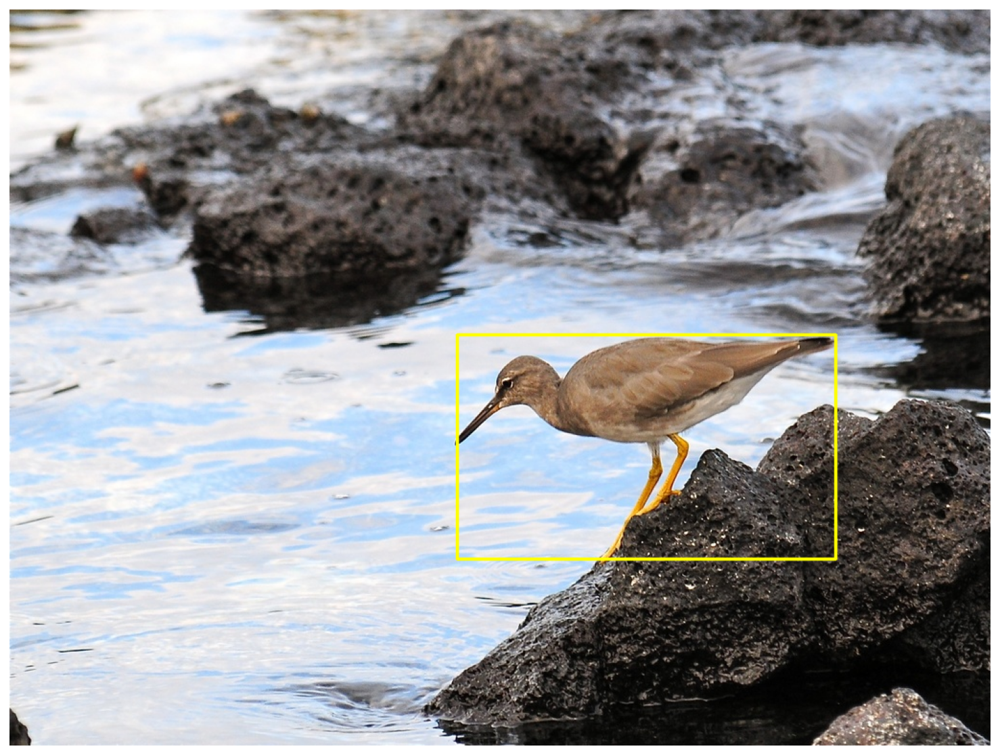

In [ ]:
show_image_objects(df_combined.iloc[0])

## Data Preprocessing

In [ ]:
train_df, test_df = train_test_split(
  df_combined, 
  test_size=0.2
)

In [ ]:
ANNOTATIONS_FILE = 'annotations.csv'
CLASSES_FILE = 'classes.csv'

In [ ]:
train_df.to_csv(ANNOTATIONS_FILE, index=False, header=None)

In [ ]:
classes = set(['Bird', 'Mouse'])

with open(CLASSES_FILE, 'w') as f:
  for i, line in enumerate(sorted(classes)):
    f.write('{},{}\n'.format(line,i))

In [ ]:
!cat classes.csv

Bird,0
Mouse,1


In [ ]:
!head annotations.csv

./train_image_folder//3a2fce4b82961316.jpg,0,0,874,514,Mouse
./train_image_folder//008ba792f7989f02.jpg,371,442,421,473,Bird
./train_image_folder//a5681c97de88c876.jpg,398,265,924,568,Mouse
./train_image_folder//0288da7ad17d53ca.jpg,166,73,664,291,Mouse
./train_image_folder//005e4b8cc9e215d8.jpg,398,75,417,94,Bird
./train_image_folder//11640527ab0d16d8.jpg,158,215,753,757,Mouse
./train_image_folder//004872d30a784ef2.jpg,741,539,848,677,Bird
./train_image_folder//007f1eeefb0c379d.jpg,430,128,877,434,Bird
./train_image_folder//00030960ec3d6aae.jpg,105,579,133,591,Bird
./train_image_folder//00255b819791bf64.jpg,604,263,839,414,Bird


## Training with a pretrained model

In [ ]:
PRETRAINED_MODEL = './checkpointed/_pretrained_model.h5'

URL_MODEL = 'https://github.com/fizyr/keras-retinanet/releases/download/0.5.1/resnet50_coco_best_v2.1.0.h5'
urllib.request.urlretrieve(URL_MODEL, PRETRAINED_MODEL)

print('Downloaded pretrained model to ' + PRETRAINED_MODEL)

Downloaded pretrained model to ./checkpointed/_pretrained_model.h5


In [ ]:
train_df.shape

(1405, 6)

In [ ]:
batch_size = 8
steps = len(train_df)/batch_size
int(steps)

175

In [ ]:
!python ./lacmus/keras_retinanet/bin/train.py --freeze-backbone --weights {PRETRAINED_MODEL} --batch-size 8 --steps 17 --epochs 50 csv annotations.csv classes.csv

2020-07-23 13:55:30.357481: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
Creating model, this may take a second...
2020-07-23 13:55:53.096158: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-07-23 13:55:53.119383: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-07-23 13:55:53.120199: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1561] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2020-07-23 13:55:53.120266: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
2020-07-23 13:55:53.122343: 

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
tensorboard_callback = tf.keras.callbacks.TensorBoard('./logs', histogram_freq=1)

In [ ]:
%tensorboard serve --logdir ./logs

Reusing TensorBoard on port 6006 (pid 4510), started 0:06:37 ago. (Use '!kill 4510' to kill it.)

<IPython.core.display.Javascript object>

## Loading the trained model

In [ ]:
!ls

annotations.csv  df_combined.csv  logs		 train_annot_folder
backend.h5	 keras-retinanet  OIDv4_ToolKit  train_image_folder
checkpointed	 keras-yolo3	  OIDv4_to_VOC
classes.csv	 lacmus		  snapshots


In [ ]:
!ls snapshots

resnet50_csv_20.h5  resnet50_csv_28.h5	resnet50_csv_35.h5  resnet50_csv_45.h5
resnet50_csv_27.h5  resnet50_csv_29.h5	resnet50_csv_37.h5


In [ ]:
# model = models.load_model('./snapshots/resnet50_csv_20.h5', backbone_name='resnet50')
# model = models.load_model('./snapshots/resnet50_csv_37.h5', backbone_name='resnet50')
model = models.load_model('./snapshots/resnet50_csv_45.h5', backbone_name='resnet50')
model = models.convert_model(model)

labels_to_names = pd.read_csv(CLASSES_FILE, header=None).T.loc[0].to_dict()

In [ ]:
labels_to_names

{0: 'Bird', 1: 'Mouse'}

## Making predictions

In [ ]:
def predict(image):
  image = preprocess_image(image.copy())
  image, scale = resize_image(image)

  boxes, scores, labels = model.predict_on_batch(
    np.expand_dims(image, axis=0)
  )

  boxes /= scale

  return boxes, scores, labels

In [ ]:
THRES_SCORE = 0.55

def draw_detections(image, boxes, scores, labels):
  for box, score, label in zip(boxes[0], scores[0], labels[0]):
    if score < THRES_SCORE:
        break

    color = label_color(label)

    b = box.astype(int)
    draw_box(image, b, color=color)

    caption = "{} {:.3f}".format(labels_to_names[label], score)
    draw_caption(image, b, caption)


In [ ]:
def show_detected_objects(image_row):
  img_path = image_row.image_name
  
  image = read_image_bgr(img_path)

  boxes, scores, labels = predict(image)

  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

  true_box = [
    image_row.x_min, image_row.y_min, image_row.x_max, image_row.y_max
  ]
  draw_box(draw, true_box, color=(255, 255, 0))

  draw_detections(draw, boxes, scores, labels)

  plt.axis('off')
  plt.imshow(draw)
  plt.show()

In [ ]:
test_df.head(10)

,image_name,x_min,y_min,x_max,y_max,class_name
159,./train_image_folder//00030960ec3d6aae.jpg,940,529,954,540,Bird
1024,./train_image_folder//10776260f503af88.jpg,401,271,554,400,Mouse
1066,./train_image_folder//1797f4e0c25701ce.jpg,370,424,538,557,Mouse
801,./train_image_folder//00c3400d818f8252.jpg,382,277,564,450,Bird
1668,./train_image_folder//d94e262db33e5c6e.jpg,681,262,771,324,Mouse
557,./train_image_folder//0060d37863e2e094.jpg,56,67,700,517,Bird
177,./train_image_folder//00046a9adb6776ad.jpg,364,308,588,506,Bird
223,./train_image_folder//001a6a36db18a4d9.jpg,652,626,674,658,Bird
232,./train_image_folder//001cecf004dc4778.jpg,128,287,140,306,Bird
1206,./train_image_folder//351968dab6439cbc.jpg,167,130,851,565,Mouse


### Testing on still images

##### Predictions that were rather accurate

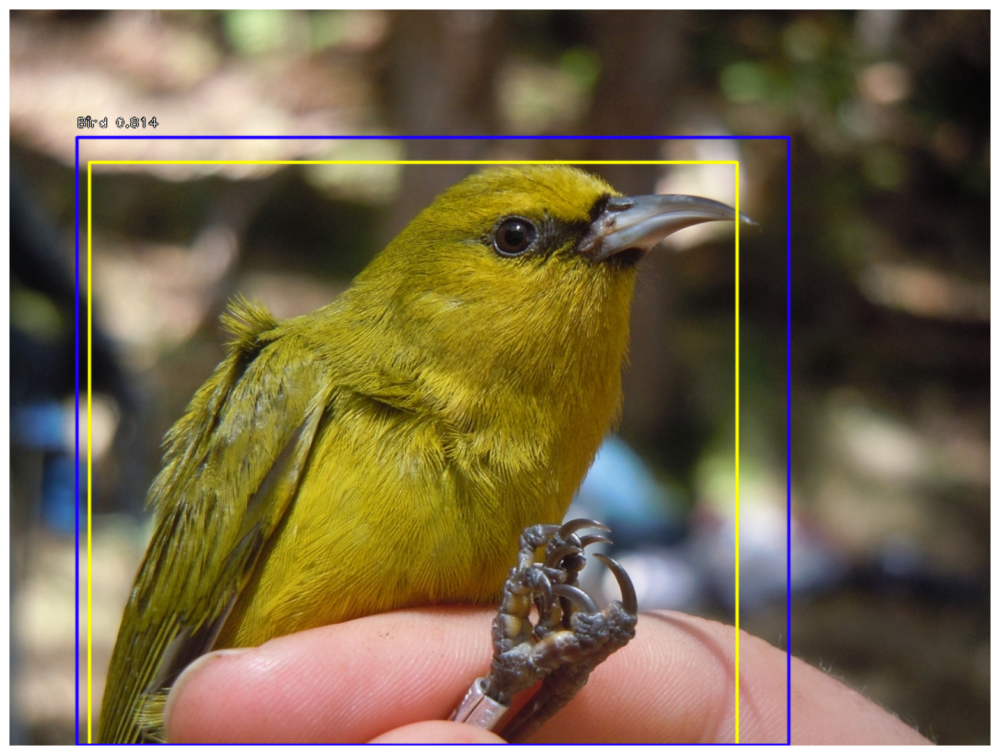

In [ ]:
show_detected_objects(test_df.iloc[178])

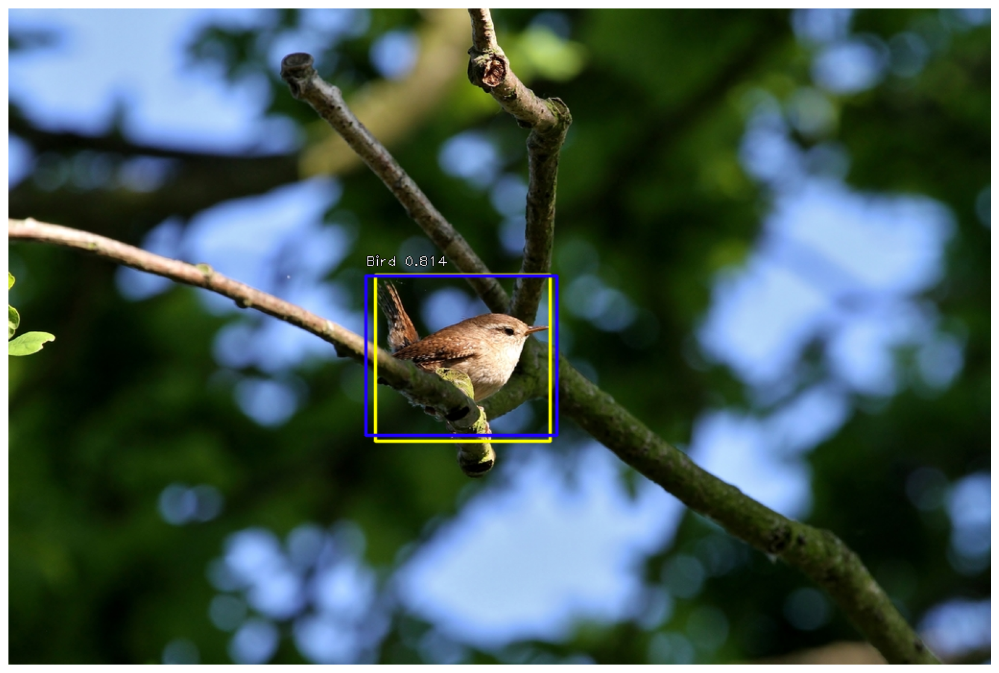

In [ ]:
show_detected_objects(test_df.iloc[3])

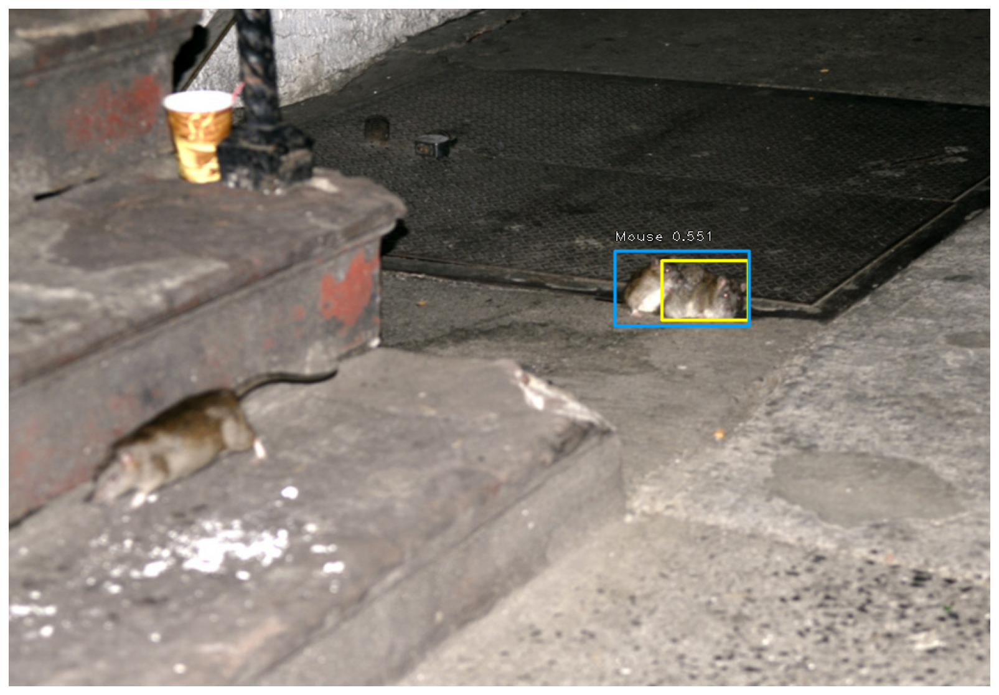

In [ ]:
show_detected_objects(test_df.iloc[4])

##### Predictions that turned out poor

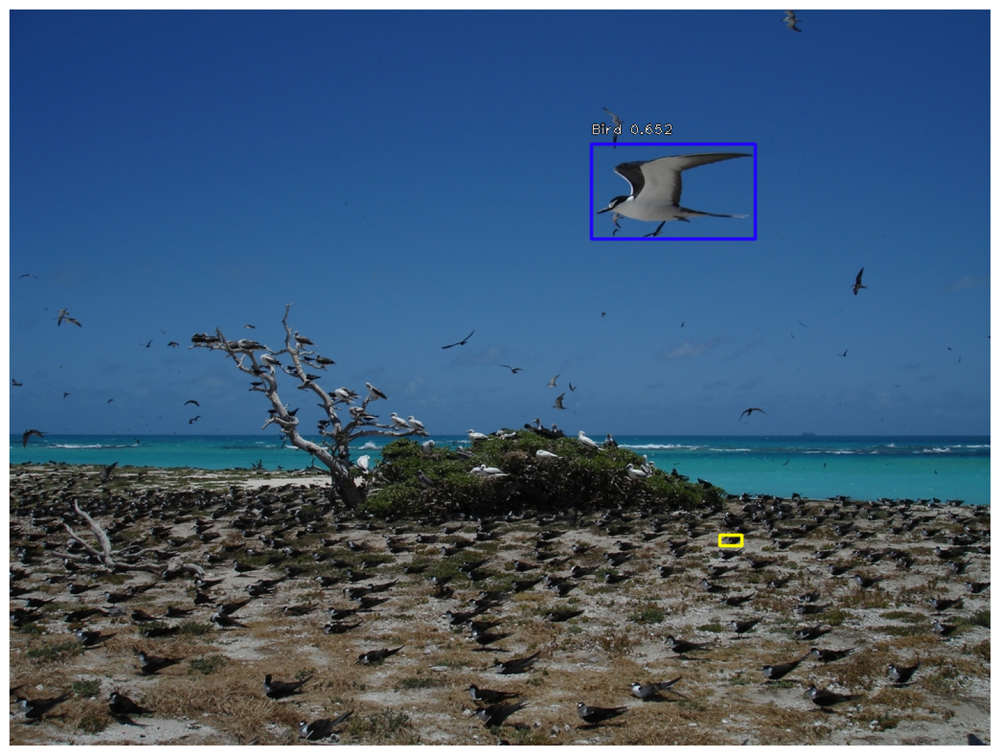

In [ ]:
show_detected_objects(test_df.iloc[13])

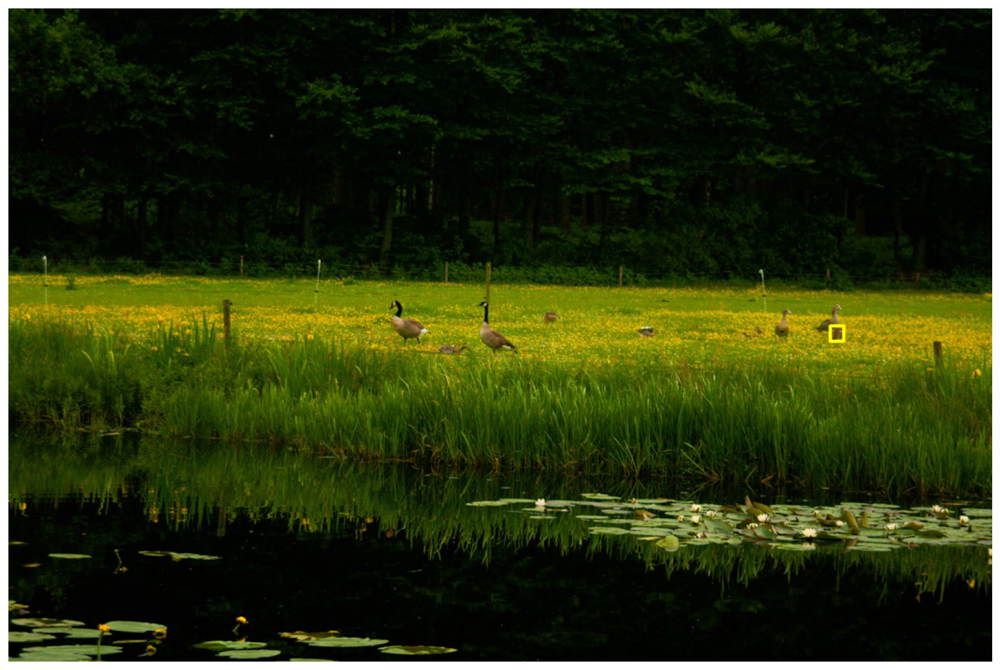

In [ ]:
show_detected_objects(test_df.iloc[111])

### Testing on a video

In [ ]:
!ls

annotations.csv  df_combined.csv  logs		 test_vid_1.mp4
backend.h5	 keras-retinanet  OIDv4_ToolKit  test_vid_2.mp4
checkpointed	 keras-yolo3	  OIDv4_to_VOC	 train_annot_folder
classes.csv	 lacmus		  snapshots	 train_image_folder


#### Original video clips

In [ ]:
video = io.open('test_vid_1.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

In [ ]:
video = io.open('test_vid_2.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

#### Break the clip down into image frames

In [ ]:
!mkdir vid_frames
!ls

annotations.csv  df_combined.csv  logs		 test_vid_1.mp4      vid_frames
backend.h5	 keras-retinanet  OIDv4_ToolKit  test_vid_2.mp4
checkpointed	 keras-yolo3	  OIDv4_to_VOC	 train_annot_folder
classes.csv	 lacmus		  snapshots	 train_image_folder


In [ ]:
%cd vid_frames/
!mkdir test1
!mkdir test2
!ls
%cd ..

/gdrive/My Drive/Dataset/vid_frames
test1  test2
/gdrive/My Drive/Dataset


#### Saving video frames

In [ ]:
vidcap = cv2.VideoCapture('test_vid_1.mp4')
success,image = vidcap.read()
count = 0
while success:
  cv2.imwrite("./vid_frames/test1/frame_%04d.jpg" % count, image)     # save frame as JPEG file      
  success,image = vidcap.read()
  print('Read a new frame: ', success, "./vid_frames/test1/frame_%04d.jpg" % count)
  count += 1

Read a new frame:  True ./vid_frames/frame_0000.jpg
Read a new frame:  True ./vid_frames/frame_0001.jpg
Read a new frame:  True ./vid_frames/frame_0002.jpg
Read a new frame:  True ./vid_frames/frame_0003.jpg
Read a new frame:  True ./vid_frames/frame_0004.jpg
Read a new frame:  True ./vid_frames/frame_0005.jpg
Read a new frame:  True ./vid_frames/frame_0006.jpg
Read a new frame:  True ./vid_frames/frame_0007.jpg
Read a new frame:  True ./vid_frames/frame_0008.jpg
Read a new frame:  True ./vid_frames/frame_0009.jpg
Read a new frame:  True ./vid_frames/frame_0010.jpg
Read a new frame:  True ./vid_frames/frame_0011.jpg
Read a new frame:  True ./vid_frames/frame_0012.jpg
Read a new frame:  True ./vid_frames/frame_0013.jpg
Read a new frame:  True ./vid_frames/frame_0014.jpg
Read a new frame:  True ./vid_frames/frame_0015.jpg
Read a new frame:  True ./vid_frames/frame_0016.jpg
Read a new frame:  True ./vid_frames/frame_0017.jpg
Read a new frame:  True ./vid_frames/frame_0018.jpg
Read a new f

In [ ]:
vidcap = cv2.VideoCapture('test_vid_2.mp4')
success,image = vidcap.read()
count = 0
while success:
  cv2.imwrite("./vid_frames/test2/frame_%04d.jpg" % count, image)     # save frame as JPEG file      
  success,image = vidcap.read()
  print('Read a new frame: ', success, "./vid_frames/test2/frame_%04d.jpg" % count)
  count += 1

Read a new frame:  True ./vid_frames/test2/frame_0000.jpg
Read a new frame:  True ./vid_frames/test2/frame_0001.jpg
Read a new frame:  True ./vid_frames/test2/frame_0002.jpg
Read a new frame:  True ./vid_frames/test2/frame_0003.jpg
Read a new frame:  True ./vid_frames/test2/frame_0004.jpg
Read a new frame:  True ./vid_frames/test2/frame_0005.jpg
Read a new frame:  True ./vid_frames/test2/frame_0006.jpg
Read a new frame:  True ./vid_frames/test2/frame_0007.jpg
Read a new frame:  True ./vid_frames/test2/frame_0008.jpg
Read a new frame:  True ./vid_frames/test2/frame_0009.jpg
Read a new frame:  True ./vid_frames/test2/frame_0010.jpg
Read a new frame:  True ./vid_frames/test2/frame_0011.jpg
Read a new frame:  True ./vid_frames/test2/frame_0012.jpg
Read a new frame:  True ./vid_frames/test2/frame_0013.jpg
Read a new frame:  True ./vid_frames/test2/frame_0014.jpg
Read a new frame:  True ./vid_frames/test2/frame_0015.jpg
Read a new frame:  True ./vid_frames/test2/frame_0016.jpg
Read a new fra

#### Making predictions on every image frame

In [ ]:
%cd vid_frames/
!mkdir pred1 pred2
!ls
%cd ..

/gdrive/My Drive/Dataset/vid_frames
pred1  pred2  test1  test2
/gdrive/My Drive/Dataset


In [ ]:
def save_detected_objects(img_path):
  image = read_image_bgr(img_path)

  boxes, scores, labels = predict(image)

  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
  draw_detections(draw, boxes, scores, labels)

  return draw

In [ ]:
imgPath1 = './vid_frames/test1/'
imgPath2 = './vid_frames/test2/'
predPath1 = './vid_frames/pred1/'
predPath2 = './vid_frames/pred2/'

for x in os.listdir(imgPath1):
    print(x)
    PATH = os.path.join(imgPath1, x)
    img_pred = save_detected_objects(PATH) # obtain numpy array
    img_pred = cv2.cvtColor(img_pred, cv2.COLOR_RGB2BGR) # convert back to BGR
    cv2.imwrite(os.path.join(predPath1, x), img_pred)
    

frame_0000.jpg
frame_0001.jpg
frame_0002.jpg
frame_0003.jpg
frame_0004.jpg
frame_0005.jpg
frame_0006.jpg
frame_0007.jpg
frame_0008.jpg
frame_0009.jpg
frame_0010.jpg
frame_0011.jpg
frame_0012.jpg
frame_0013.jpg
frame_0014.jpg
frame_0015.jpg
frame_0016.jpg
frame_0017.jpg
frame_0018.jpg
frame_0019.jpg
frame_0020.jpg
frame_0021.jpg
frame_0022.jpg
frame_0023.jpg
frame_0024.jpg
frame_0025.jpg
frame_0026.jpg
frame_0027.jpg
frame_0028.jpg
frame_0029.jpg
frame_0030.jpg
frame_0031.jpg
frame_0032.jpg
frame_0033.jpg
frame_0034.jpg
frame_0035.jpg
frame_0036.jpg
frame_0037.jpg
frame_0038.jpg
frame_0039.jpg
frame_0040.jpg
frame_0041.jpg
frame_0042.jpg
frame_0043.jpg
frame_0044.jpg
frame_0045.jpg
frame_0046.jpg
frame_0047.jpg
frame_0048.jpg
frame_0049.jpg
frame_0050.jpg
frame_0051.jpg
frame_0052.jpg
frame_0053.jpg
frame_0054.jpg
frame_0055.jpg
frame_0056.jpg
frame_0057.jpg
frame_0058.jpg
frame_0059.jpg
frame_0060.jpg
frame_0061.jpg
frame_0062.jpg
frame_0063.jpg
frame_0064.jpg
frame_0065.jpg
frame_0066

In [ ]:
for x in os.listdir(imgPath2):
    print(x)
    PATH = os.path.join(imgPath2, x)
    img_pred = save_detected_objects(PATH) # obtain numpy array
    img_pred = cv2.cvtColor(img_pred, cv2.COLOR_RGB2BGR) # convert back to BGR
    cv2.imwrite(os.path.join(predPath2, x), img_pred)

frame_0000.jpg
frame_0001.jpg
frame_0002.jpg
frame_0003.jpg
frame_0004.jpg
frame_0005.jpg
frame_0006.jpg
frame_0007.jpg
frame_0008.jpg
frame_0009.jpg
frame_0010.jpg
frame_0011.jpg
frame_0012.jpg
frame_0013.jpg
frame_0014.jpg
frame_0015.jpg
frame_0016.jpg
frame_0017.jpg
frame_0018.jpg
frame_0019.jpg
frame_0020.jpg
frame_0021.jpg
frame_0022.jpg
frame_0023.jpg
frame_0024.jpg
frame_0025.jpg
frame_0026.jpg
frame_0027.jpg
frame_0028.jpg
frame_0029.jpg
frame_0030.jpg
frame_0031.jpg
frame_0032.jpg
frame_0033.jpg
frame_0034.jpg
frame_0035.jpg
frame_0036.jpg
frame_0037.jpg
frame_0038.jpg
frame_0039.jpg
frame_0040.jpg
frame_0041.jpg
frame_0042.jpg
frame_0043.jpg
frame_0044.jpg
frame_0045.jpg
frame_0046.jpg
frame_0047.jpg
frame_0048.jpg
frame_0049.jpg
frame_0050.jpg
frame_0051.jpg
frame_0052.jpg
frame_0053.jpg
frame_0054.jpg
frame_0055.jpg
frame_0056.jpg
frame_0057.jpg
frame_0058.jpg
frame_0059.jpg
frame_0060.jpg
frame_0061.jpg
frame_0062.jpg
frame_0063.jpg
frame_0064.jpg
frame_0065.jpg
frame_0066

#### Obtain video specs

##### Test video 1

In [ ]:
# Open the input video file
input_vid = cv2.VideoCapture("test_vid_1.mp4")
length = int(input_vid.get(cv2.CAP_PROP_FRAME_COUNT))

# get capture properties 
width = input_vid.get(cv2.CAP_PROP_FRAME_WIDTH)   # width
height = input_vid.get(cv2.CAP_PROP_FRAME_HEIGHT) # height
frame_rate = input_vid.get(cv2.CAP_PROP_FPS) # cap

print('length:',length)
print('width:',width)
print('height:',height)
print('frame_rate:',frame_rate)

length: 599
width: 1280.0
height: 720.0
frame_rate: 29.97


##### Test video 2

In [ ]:
# Open the input video file
input_vid = cv2.VideoCapture("test_vid_2.mp4")
length = int(input_vid.get(cv2.CAP_PROP_FRAME_COUNT))

# get capture properties 
width = input_vid.get(cv2.CAP_PROP_FRAME_WIDTH)   # width
height = input_vid.get(cv2.CAP_PROP_FRAME_HEIGHT) # height
frame_rate = input_vid.get(cv2.CAP_PROP_FPS) # cap

print('length:',length)
print('width:',width)
print('height:',height)
print('frame_rate:',frame_rate)

length: 867
width: 1280.0
height: 720.0
frame_rate: 30.03429521599058


#### Stitch the images back into the original videos

##### Test video 1 with ODS

In [ ]:
# Get the images and sort them
imgPath = './vid_frames/pred1/'
files = sorted(os.listdir(imgPath))

# Get image height and width sizes
test_image = cv2.imread(imgPath + files[0])
height , width , layers =  test_image.shape
print('images are height:',height,' width:',width,' layers:',layers)

# Make a video writer
output_filepath = 'pred_01.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID') # .avi codec

# output_movie = cv2.VideoWriter('output.avi', fourcc, frame_rate, (width, height))
video = cv2.VideoWriter(output_filepath, fourcc, 29.97, (width, height))

# Write the files to the video file
for img in files:
  if not img.endswith('.jpg'):
            continue
  shot = cv2.imread(imgPath+img)
  video.write(shot)

#close the video file
video.release()
print("video created")

images are height: 720  width: 1280  layers: 3
video created


In [ ]:
# Convert to .mp4 file
!ffmpeg -i pred_01.avi -vcodec libx264 -crf 25 -acodec libfaac -threads 0 pred_01.mp4

ffmpeg version 3.4.6-0ubuntu0.18.04.1 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.3.0-16ubuntu3)
  configuration: --prefix=/usr --extra-version=0ubuntu0.18.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --ena

In [ ]:
video = io.open('pred_01.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

##### Test video 2 with ODS

In [ ]:
# Get the images and sort them
imgPath = './vid_frames/pred2/'
files = sorted(os.listdir(imgPath))

# Get image height and width sizes
test_image = cv2.imread(imgPath + files[0])
height , width , layers =  test_image.shape
print('images are height:',height,' width:',width,' layers:',layers)

# Make a video writer
output_filepath = 'pred_02.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID') # .avi codec

# output_movie = cv2.VideoWriter('output.avi', fourcc, frame_rate, (width, height))
video = cv2.VideoWriter(output_filepath, fourcc, 30.03429521599058, (width, height))

# Write the files to the video file
for img in files:
  if not img.endswith('.jpg'):
            continue
  shot = cv2.imread(imgPath+img)
  video.write(shot)

#close the video file
video.release()
print("video created")

images are height: 720  width: 1280  layers: 3
video created


In [ ]:
# Convert to .mp4 file
!ffmpeg -i pred_01.avi -vcodec libx264 -crf 25 -acodec libfaac -threads 0 pred_02.mp4

ffmpeg version 3.4.6-0ubuntu0.18.04.1 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.3.0-16ubuntu3)
  configuration: --prefix=/usr --extra-version=0ubuntu0.18.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --ena

In [ ]:
video = io.open('pred_02.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))